# Introduction 

This project analyses data from on-line dating application OKCupid. The goal of this project is to scope, prep, analyse, and create a machine learning model to predict the body type and income of an user.


**Data sources:**

`profiles.csv` was provided by Codecademy.com.

## Scoping


### Project Goals

The goal is to put in practice the skills learned through Codecademy and apply machine learning techniques to a data set. The questions that will be answered are whether an OkCupid's user income and body type can be predicted using other variables from their profiles. As 99.84% of the users stated California as their location and this feature will be used to predict the income. The first question will be explored analysing only this subset.  


### Data

The project has one data set provided by Codecademy called `profiles.csv`. In the data, each row represents an OkCupid user and the columns are the responses to their user profiles which include multi-choice and short answer questions.

### Analysis

This solution will use descriptive statistics and data visualization to find key figures in understanding the distribution, count, and relationship between variables. Since the goal of the project to make predictions on the user's income and body type, classification algorithms from the supervised learning family of machine learning models will be implemented. 

### Evaluation

The project will conclude with the evaluation of the machine learning model selected with a validation data set. The output of the predictions can be checked through a confusion matrix, and metrics such as accuracy, precision, recall, F1 and Kappa scores. 


## Import Python Modules

In [861]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt


In [862]:
profiles = pd.read_csv('profiles.csv')
profiles.head()

,age,body_type,diet,drinks,drugs,education,essay0,essay1,essay2,essay3,...,location,offspring,orientation,pets,religion,sex,sign,smokes,speaks,status
0,22,a little extra,strictly anything,socially,never,working on college/university,about me:<br />\n<br />\ni would love to think...,currently working as an international agent fo...,making people laugh.<br />\nranting about a go...,"the way i look. i am a six foot half asian, ha...",...,"south san francisco, california","doesn&rsquo;t have kids, but might want them",straight,likes dogs and likes cats,agnosticism and very serious about it,m,gemini,sometimes,english,single
1,35,average,mostly other,often,sometimes,working on space camp,i am a chef: this is what that means.<br />\n1...,dedicating everyday to being an unbelievable b...,being silly. having ridiculous amonts of fun w...,NaN,...,"oakland, california","doesn&rsquo;t have kids, but might want them",straight,likes dogs and likes cats,agnosticism but not too serious about it,m,cancer,no,"english (fluently), spanish (poorly), french (...",single
2,38,thin,anything,socially,NaN,graduated from masters program,"i'm not ashamed of much, but writing public te...","i make nerdy software for musicians, artists, ...",improvising in different contexts. alternating...,my large jaw and large glasses are the physica...,...,"san francisco, california",NaN,straight,has cats,NaN,m,pisces but it doesn&rsquo;t matter,no,"english, french, c++",available
3,23,thin,vegetarian,socially,NaN,working on college/university,i work in a library and go to school. . .,reading things written by old dead people,playing synthesizers and organizing books acco...,socially awkward but i do my best,...,"berkeley, california",doesn&rsquo;t want kids,straight,likes cats,NaN,m,pisces,no,"english, german (poorly)",single
4,29,athletic,NaN,socially,never,graduated from college/university,hey how's it going? currently vague on the pro...,work work work work + play,creating imagery to look at:<br />\nhttp://bag...,i smile a lot and my inquisitive nature,...,"san francisco, california",NaN,straight,likes dogs and likes cats,NaN,m,aquarius,no,english,single


In [863]:
profiles.shape

(59946, 31)

In [864]:
profiles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59946 entries, 0 to 59945
Data columns (total 31 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   age          59946 non-null  int64  
 1   body_type    54650 non-null  object 
 2   diet         35551 non-null  object 
 3   drinks       56961 non-null  object 
 4   drugs        45866 non-null  object 
 5   education    53318 non-null  object 
 6   essay0       54458 non-null  object 
 7   essay1       52374 non-null  object 
 8   essay2       50308 non-null  object 
 9   essay3       48470 non-null  object 
 10  essay4       49409 non-null  object 
 11  essay5       49096 non-null  object 
 12  essay6       46175 non-null  object 
 13  essay7       47495 non-null  object 
 14  essay8       40721 non-null  object 
 15  essay9       47343 non-null  object 
 16  ethnicity    54266 non-null  object 
 17  height       59943 non-null  float64
 18  income       59946 non-null  int64  
 19  job 

In [865]:
profiles.columns

Index(['age', 'body_type', 'diet', 'drinks', 'drugs', 'education', 'essay0',
       'essay1', 'essay2', 'essay3', 'essay4', 'essay5', 'essay6', 'essay7',
       'essay8', 'essay9', 'ethnicity', 'height', 'income', 'job',
       'last_online', 'location', 'offspring', 'orientation', 'pets',
       'religion', 'sex', 'sign', 'smokes', 'speaks', 'status'],
      dtype='object')

#### Data Characteristics

`profiles` has 59,946 rows and 31 columns.

The columns in the dataset include: 

- **age:** continuous variable of age of user
- **body_type:** categorical variable of body type of user
- **diet:** categorical variable of dietary information
- **drinks:**  categorical variable of alcohol consumption
- **drugs:** categorical variable of drug usage
- **education:** categorical variable of educational attainment
- **ethnicity:** categorical variable of ethnic backgrounds
- **height:** continuous variable of height of user
- **income:** continuous variable of income of user
- **job:** categorical variable of employment description
- **offspring:** categorical variable of children status
- **orientation:** categorical variable of sexual orientation
- **pets:** categorical variable of pet preferences
- **religion:** categorical variable of religious background
- **sex:** categorical variable of gender
- **sign:** categorical variable of astrological symbol
- **smokes:** categorical variable of smoking consumption
- **speaks:** categorical variable of language spoken
- **status:** categorical variable of relationship status
- **last_online:** date variable of last login
- **location:** categorical variable of user locations

And a set of open short-answer responses to :

- **essay0:** My self summary
- **essay1:**  What I’m doing with my life
- **essay2:** I’m really good at
- **essay3:** The first thing people usually notice about me
- **essay4:** Favorite books, movies, show, music, and food
- **essay5:** The six things I could never do without
- **essay6:** I spend a lot of time thinking about
- **essay7:** On a typical Friday night I am
- **essay8:** The most private thing I am willing to admit
- **essay9:** You should message me if…

## Income prediction

### Exploration and cleaning of the data

#### Income

First, consider the `income` column  as this is what we want to predict. Note that 48442 which is approximately 80.8% of the users did not give their income. 

In [866]:
print("Number of categories:",profiles.income.nunique())
print("Categories:", profiles.income.unique())

profiles.income.value_counts()

Number of categories: 13
Categories: [     -1   80000   20000   40000   30000   50000   60000 1000000  150000
  100000  500000   70000  250000]


income
-1          48442
 20000       2952
 100000      1621
 80000       1111
 30000       1048
 40000       1005
 50000        975
 60000        736
 70000        707
 150000       631
 1000000      521
 250000       149
 500000        48
Name: count, dtype: int64

<Axes: xlabel='count', ylabel='income'>

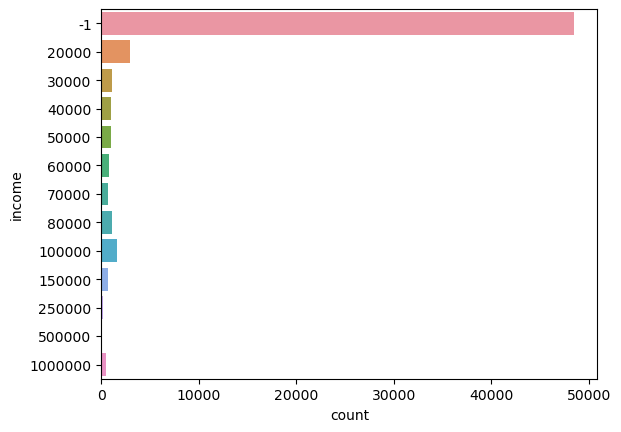

In [867]:
sns.countplot(data=profiles, y='income')

<Axes: xlabel='income', ylabel='Count'>

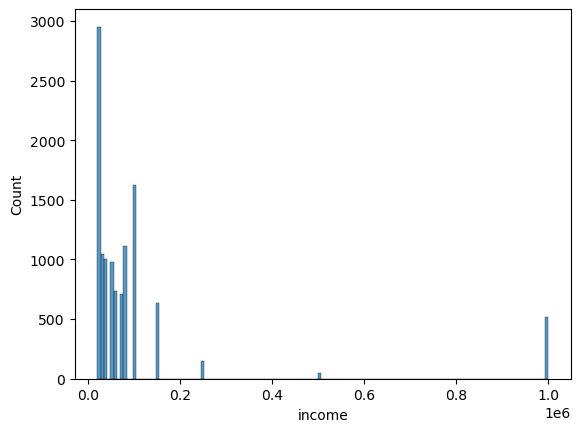

In [868]:
sns.histplot(data=profiles['income'][profiles['income']!=-1])

It is important to clarify that the rows with -1 do not correspond to students as they potentially might not have income. Nevertheless, looking at the students' income it can be seen that there are some students in each of the income categories. Therefore, we cannot replace them with zero.

In [869]:
profiles['income'][profiles.job == 'student'].value_counts()

income
-1          3890
 20000       817
 30000        64
 1000000      49
 40000        18
 50000        10
 60000         9
 80000         8
 500000        6
 70000         5
 100000        3
 250000        2
 150000        1
Name: count, dtype: int64

#### Location

In [870]:
print("Number of categories:",profiles.location.nunique())
print("Categories:", profiles.location.unique())

profiles.location.value_counts()

Number of categories: 199
Categories: ['south san francisco, california' 'oakland, california'
 'san francisco, california' 'berkeley, california'
 'belvedere tiburon, california' 'san mateo, california'
 'daly city, california' 'san leandro, california' 'atherton, california'
 'san rafael, california' 'walnut creek, california'
 'menlo park, california' 'belmont, california' 'san jose, california'
 'palo alto, california' 'emeryville, california' 'el granada, california'
 'castro valley, california' 'fairfax, california'
 'mountain view, california' 'burlingame, california'
 'martinez, california' 'pleasant hill, california' 'hayward, california'
 'alameda, california' 'vallejo, california' 'benicia, california'
 'el cerrito, california' 'mill valley, california' 'richmond, california'
 'redwood city, california' 'el sobrante, california'
 'stanford, california' 'san pablo, california' 'novato, california'
 'pacifica, california' 'lafayette, california'
 'half moon bay, california' 'f

location
san francisco, california         31064
oakland, california                7214
berkeley, california               4212
san mateo, california              1331
palo alto, california              1064
                                  ...  
south wellfleet, massachusetts        1
orange, california                    1
astoria, new york                     1
london, united kingdom                1
rochester, michigan                   1
Name: count, Length: 199, dtype: int64

First, we will reduce the amount of unique values since having 199 would be quite difficult. By taking just the state or country for those people with location outside USA, we can reduce the amount of unique values to 41.

In [871]:
profiles['location_by_state_or_country'] = profiles.location.str.split(',').str.get(-1).str.strip()
print("Number of categories:",profiles.location_by_state_or_country.nunique())
print("Categories:", profiles.location_by_state_or_country.unique())

profiles.location_by_state_or_country.value_counts()


Number of categories: 41
Categories: ['california' 'colorado' 'new york' 'oregon' 'arizona' 'hawaii' 'montana'
 'wisconsin' 'virginia' 'spain' 'nevada' 'illinois' 'vietnam' 'ireland'
 'louisiana' 'michigan' 'texas' 'united kingdom' 'massachusetts'
 'north carolina' 'idaho' 'mississippi' 'new jersey' 'florida' 'minnesota'
 'georgia' 'utah' 'washington' 'west virginia' 'connecticut' 'tennessee'
 'rhode island' 'district of columbia' 'canada' 'missouri' 'germany'
 'pennsylvania' 'netherlands' 'switzerland' 'mexico' 'ohio']


location_by_state_or_country
california              59855
new york                   17
illinois                    8
massachusetts               5
texas                       4
oregon                      4
michigan                    4
arizona                     3
florida                     3
district of columbia        2
washington                  2
utah                        2
georgia                     2
minnesota                   2
colorado                    2
united kingdom              2
ohio                        2
spain                       2
virginia                    2
hawaii                      2
louisiana                   1
tennessee                   1
mexico                      1
switzerland                 1
netherlands                 1
pennsylvania                1
germany                     1
missouri                    1
canada                      1
rhode island                1
connecticut                 1
ireland                     1
west virgin

As 99.84% of the users are from California we will consider only people with californian cities/towns as their location. For simplicity we will call that column `city`. On the other hand, one can argue that considering only the state, this column does not provide significant information gain (variance).

In [872]:
profiles['city'] = profiles.location.str.split(',').str.get(0).str.strip()
profiles2 = profiles[profiles.location_by_state_or_country == 'california'].copy()
print(profiles2.city.nunique())

135


Then since we have 135 unique values we will classify them by county. This was coded by hand as no appropiate information was provided. Later we will remove the rows with value none in the `county` columns since they represent counties with just one user and there are 16 rows of this type. These can be omitted as they will not have an impact in our machine learning model. Now we have 14 categories 

In [873]:
profiles2['county'] = 'none'
profiles2.loc[profiles2.city.isin(['alameda', 'berkeley', 'oakland', 'hayward', 'emeryville', 'san leandro', 'castro valley', 'albany', 'san lorenzo', 'fremont', 'piedmont', 'west oakland', 'union city', 'ashland']), 'county'] = 'alameda'
profiles2.loc[profiles2.city.isin(['san francisco']), 'county'] = 'san francisco'
profiles2.loc[profiles2.city.isin(['san mateo', 'redwood city', 'daly city', 'menlo park', 'south san francisco', 'burlingame', 'pacifica', 'san bruno', 'belmont', 'san carlos', 'millbrae', 'half moon bay', 'atherton', 'brisbane', 'el granada', 'foster city', 'east palo alto', 'montara', 'woodside', 'moss beach', 'colma', 'hillsborough', 'bayshore', 'redwood shores']), 'county'] = 'san mateo'
profiles2.loc[profiles2.city.isin(['palo alto', 'mountain view', 'stanford', 'los gatos', 'san jose', 'campbell', 'milpitas', 'santa clara', 'sunnyvale']), 'county'] = 'santa clara'
profiles2.loc[profiles2.city.isin(['san rafael', 'novato', 'mill valley', 'sausalito', 'san anselmo', 'fairfax', 'green brae', 'larkspur', 'corte madera', 'belvedere tiburon', 'kentfield', 'woodacre', 'ross', 'lagunitas', 'san geronimo', 'bolinas', 'tiburon', 'stinson beach', 'nicasio', 'forest knolls', 'san quentin', 'marin city', 'muir beach', 'hilarita', 'olema']), 'county'] = 'marin'
profiles2.loc[profiles2.city.isin(['walnut creek', 'richmond', 'pleasant hill', 'el cerrito', 'martinez', 'san pablo', 'lafayette', 'el sobrante', 'hercules', 'pinole', 'orinda', 'moraga', 'rodeo', 'crockett', 'point richmond', 'kensington', 'oakley', 'pacheco', 'port costa', 'concord']), 'county'] = 'contra costa'
profiles2.loc[profiles2.city.isin(['vallejo', 'benicia', 'glencove', 'vacaville']), 'county'] = 'solano'
profiles2.loc[profiles2.city.isin(['westlake', 'los angeles', 'santa monica', 'north hollywood', 'hacienda heights', 'studio city', 'long beach', 'pasadena', 'arcadia']), 'county'] = 'los angeles'
profiles2.loc[profiles2.city.isin(['san diego']), 'county'] = 'san diego'
profiles2.loc[profiles2.city.isin(['santa cruz', 'freedom']), 'county'] = 'santa cruz'
profiles2.loc[profiles2.city.isin(['santa rosa', 'petaluma', 'rohnert park']), 'county'] = 'sonoma'
profiles2.loc[profiles2.city.isin(['sacramento']), 'county'] = 'sacramento'
profiles2.loc[profiles2.city.isin(['napa']), 'county'] = 'napa'
profiles2.loc[profiles2.city.isin(['irvine', 'costa mesa', 'santa ana', 'brea', 'orange']), 'county'] = 'orange'

Most of the users are from San Francisco, Alameda and San Mateo.

In [874]:
profiles2.county.value_counts()

county
san francisco    31064
alameda          15296
san mateo         5492
contra costa      3091
marin             2279
santa clara       1797
solano             763
los angeles         30
none                16
santa cruz           6
san diego            6
orange               6
sonoma               5
sacramento           2
napa                 2
Name: count, dtype: int64

<Axes: xlabel='count', ylabel='county'>

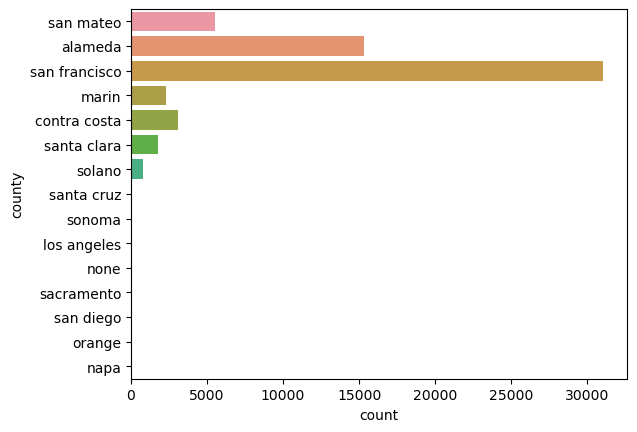

In [875]:
sns.countplot(data=profiles2, y='county')

In [876]:
profiles2= profiles2.loc[profiles2.city != 'none']
profiles2.shape

(59855, 34)

We define a new dataframe where we remove the rows corresponding to the users that did not provide their `income` and did not live in the counties of the profiles2 dataframe.

In [877]:
profiles3 = profiles2.loc[profiles2.income != -1].copy()
profiles3.shape

(11489, 34)

#### Job

From now on we will consider only the profiles3 data frame

The `job` column shows 21 categories which seem already group in appropiate categories. We can see that the categories other, computer/hardware/software and students are the most common, while retired, rather not say and military are the least common.  

In [878]:
print("Number of categories:",profiles3.job.nunique())
print("Categories:", profiles3.job.unique())

profiles3.job.value_counts()

Number of categories: 21
Categories: ['hospitality / travel' 'student' 'banking / financial / real estate'
 'sales / marketing / biz dev' 'other' 'construction / craftsmanship'
 'artistic / musical / writer' 'education / academia'
 'law / legal services' 'entertainment / media' 'executive / management'
 'medicine / health' 'computer / hardware / software'
 'science / tech / engineering' 'transportation' 'retired' nan
 'rather not say' 'political / government' 'unemployed' 'military'
 'clerical / administrative']


job
other                                1539
computer / hardware / software       1155
artistic / musical / writer          1039
student                               991
science / tech / engineering          974
sales / marketing / biz dev           870
education / academia                  737
medicine / health                     648
executive / management                557
entertainment / media                 459
banking / financial / real estate     365
construction / craftsmanship          357
hospitality / travel                  345
law / legal services                  217
clerical / administrative             204
political / government                194
transportation                        140
unemployed                            101
military                               98
rather not say                         89
retired                                70
Name: count, dtype: int64

<Axes: xlabel='count', ylabel='job'>

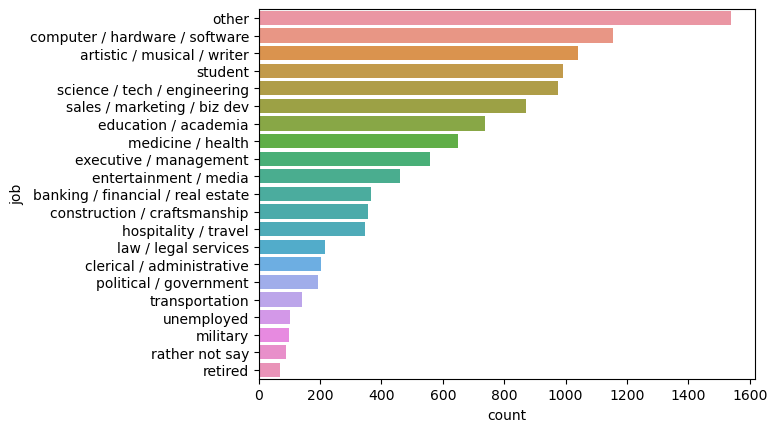

In [879]:
sns.countplot(data=profiles3, y='job', order = profiles3['job'].value_counts().index)

If we compare this with the entire dataset, we can see that there no significant variation in the distribution of the categories.

#### Education

Next we look at the `education` column. We can see that some categories can be combined for instance graduated from college/university and college/university

In [880]:
print("Number of categories:",profiles3.education.nunique())
print("Categories:", profiles3.education.unique())

profiles3.education.value_counts()

Number of categories: 31
Categories: ['working on space camp' 'working on college/university'
 'graduated from college/university' 'graduated from high school'
 'dropped out of space camp' 'graduated from space camp'
 'graduated from law school' 'graduated from masters program'
 'graduated from two-year college' nan 'working on med school'
 'college/university' 'dropped out of high school'
 'working on ph.d program' 'graduated from ph.d program'
 'two-year college' 'dropped out of college/university'
 'dropped out of two-year college' 'dropped out of med school'
 'high school' 'working on masters program' 'working on two-year college'
 'working on high school' 'masters program' 'graduated from med school'
 'space camp' 'dropped out of masters program' 'working on law school'
 'dropped out of ph.d program' 'ph.d program' 'dropped out of law school'
 'law school']


education
graduated from college/university    4210
graduated from masters program       1509
working on college/university        1384
graduated from high school            562
graduated from two-year college       509
working on two-year college           392
dropped out of college/university     360
working on masters program            253
graduated from ph.d program           218
working on ph.d program               187
graduated from space camp             180
dropped out of space camp             156
graduated from law school             150
college/university                    133
working on space camp                 113
dropped out of two-year college        92
two-year college                       57
dropped out of high school             48
graduated from med school              42
high school                            33
dropped out of masters program         33
working on med school                  32
dropped out of ph.d program            26
working on high school  

We can see that the distribution of the categories of the dataset that will be used for the income prediction is similar to the complete dataset. Most of the users have gradauted from college/university education.   

<Axes: xlabel='count', ylabel='education'>

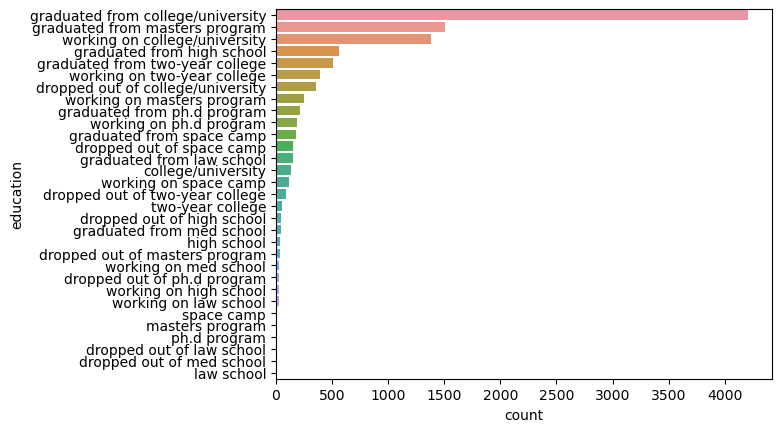

In [881]:
sns.countplot(data=profiles3, y='education', order = profiles3['education'].value_counts().index)

<Axes: xlabel='count', ylabel='education'>

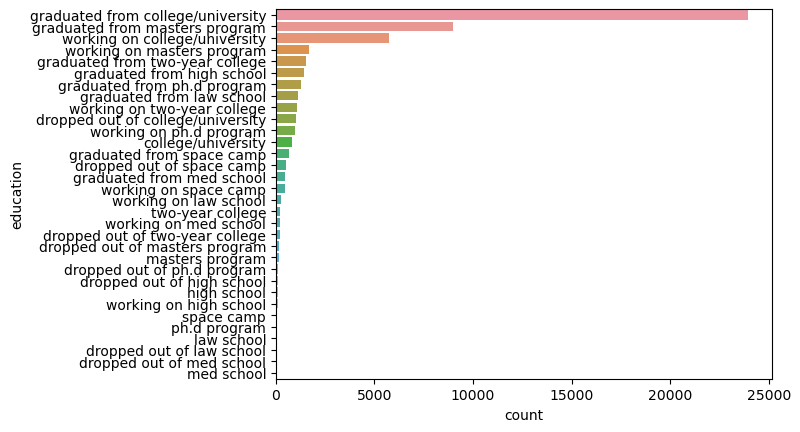

In [882]:
sns.countplot(data=profiles, y='education', order = profiles['education'].value_counts().index)

In [883]:
profiles3['education'] = profiles3.education.replace('college/university', 'graduated from college/university')
profiles3['education'] = profiles3.education.replace('masters program', 'graduated from masters program')
profiles3['education'] = profiles3.education.replace('ph.d program', 'graduated from ph.d program')
profiles3['education'] = profiles3.education.replace('high school', 'graduated from high school')
profiles3['education'] = profiles3.education.replace('med school', 'graduated from med school')
profiles3['education'] = profiles3.education.replace('law school', 'graduated from law school')
profiles3['education'] = profiles3.education.replace('two-year college', 'graduated from two-year college')
profiles3['education'] = profiles3.education.replace('space camp', 'graduated from space camp')

profiles3.education.value_counts()

education
graduated from college/university    4343
graduated from masters program       1521
working on college/university        1384
graduated from high school            595
graduated from two-year college       566
working on two-year college           392
dropped out of college/university     360
working on masters program            253
graduated from ph.d program           223
graduated from space camp             193
working on ph.d program               187
dropped out of space camp             156
graduated from law school             152
working on space camp                 113
dropped out of two-year college        92
dropped out of high school             48
graduated from med school              42
dropped out of masters program         33
working on med school                  32
dropped out of ph.d program            26
working on high school                 24
working on law school                  24
dropped out of law school               5
dropped out of med schoo

<Axes: xlabel='count', ylabel='education'>

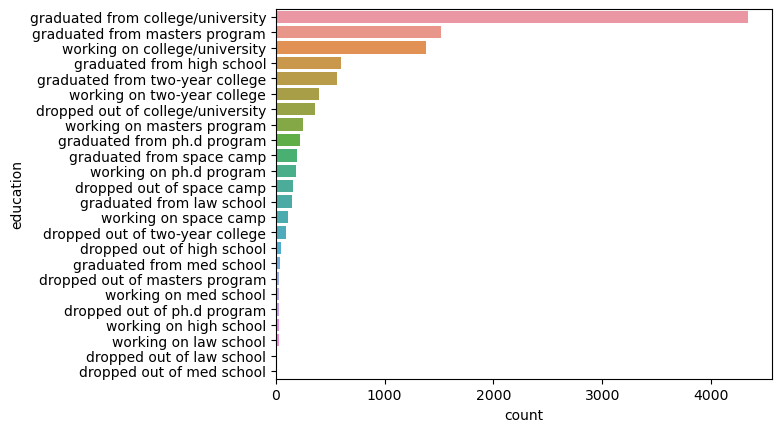

In [884]:
sns.countplot(data=profiles3, y='education', order = profiles3['education'].value_counts().index)

#### Sex

Let us look at the distribution of males and females of the data frame profiles3

In [885]:
print('Number of categories:',profiles3.sex.nunique())
print('Categories:', profiles3.sex.unique())

profiles3.sex.value_counts()

Number of categories: 2
Categories: ['m' 'f']


sex
m    8379
f    3110
Name: count, dtype: int64

We can see that most of the users are males. However, we can see that in the dataframe profiles3 now we have more than 2 times the amount male users compared to the complete dataset. 

<Axes: xlabel='count', ylabel='sex'>

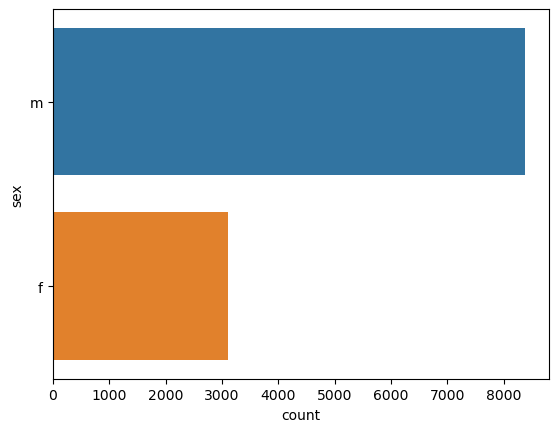

In [886]:
sns.countplot(data=profiles3, y='sex', order = profiles3['sex'].value_counts().index)

<Axes: xlabel='count', ylabel='sex'>

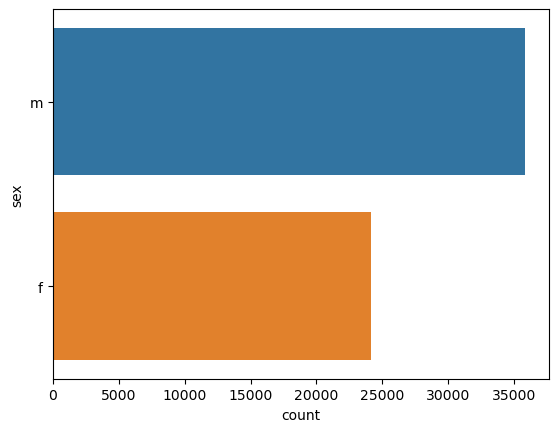

In [887]:
sns.countplot(data=profiles, y='sex', order = profiles['sex'].value_counts().index)

#### Age

The `age` column has 52 categories, it is more convenient to group them in some age intervals. Most of the users are adults in their late 20's and early 30's, we can see a similar distribution in out selection of data compared to the complete dataset.

In [888]:
print('Number of categories:',profiles3.age.nunique())
print('Categories:', profiles3.age.unique())

profiles3.age.value_counts()

Number of categories: 52
Categories: [35 23 28 30 29 40 31 22 21 34 25 41 39 27 50 59 24 26 37 42 33 66 53 32
 36 47 45 61 48 52 44 18 20 19 38 43 64 57 60 51 49 46 58 69 62 55 56 54
 68 65 63 67]


age
27    678
25    669
28    662
26    652
29    597
24    588
30    554
23    529
31    479
32    476
22    413
33    391
34    366
35    313
21    305
37    288
36    286
38    271
20    250
42    228
39    227
41    213
40    193
43    174
44    138
45    129
46    123
47    111
19    110
48    103
49     87
50     85
52     75
56     65
51     64
18     64
54     62
57     60
55     60
59     46
58     42
61     34
53     34
60     33
65     31
62     30
66     24
63     23
64     18
68     17
67     15
69      4
Name: count, dtype: int64

<Axes: xlabel='age', ylabel='Count'>

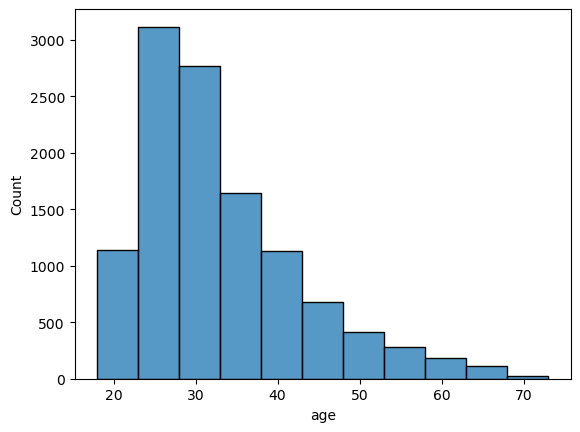

In [889]:
sns.histplot(profiles3.age, binwidth=5)

<Axes: xlabel='age', ylabel='Count'>

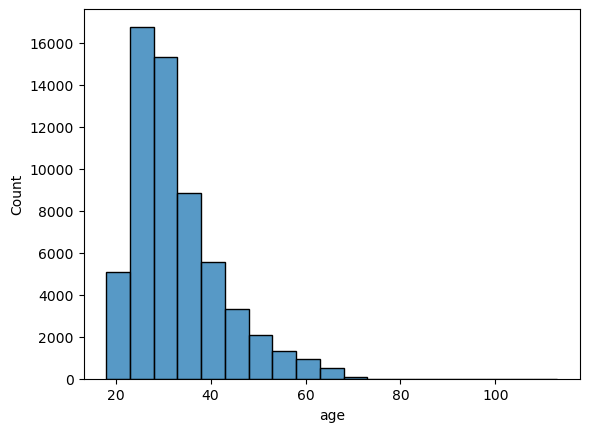

In [890]:
sns.histplot(profiles.age, binwidth=5)

In [891]:
profiles3['age_interval'] = 'none'
profiles3.loc[profiles3.age.isin([18, 19, 20, 21, 22]), 'age_interval'] = '18-22'
profiles3.loc[profiles3.age.isin([23, 24, 25, 26, 27]), 'age_interval'] = '23-27'
profiles3.loc[profiles3.age.isin([27, 28, 29, 30, 31]), 'age_interval'] = '28-31'
profiles3.loc[profiles3.age.isin([32, 33, 34, 35, 36]), 'age_interval'] = '32-36'
profiles3.loc[profiles3.age.isin([37, 38, 39, 40, 41]), 'age_interval'] = '37-41' 
profiles3.loc[profiles3.age.isin([42, 43, 44, 45, 46]), 'age_interval'] = '42-46'
profiles3.loc[profiles3.age.isin([47, 48, 49, 50, 51]), 'age_interval'] = '47-51'
profiles3.loc[profiles3.age.isin([52, 53, 54, 55, 56]), 'age_interval'] = '52-56'
profiles3.loc[profiles3.age.isin([57, 58, 59, 60, 61]), 'age_interval'] = '57-61' 
profiles3.loc[profiles3.age.isin([62, 63, 64, 65, 66]), 'age_interval'] = '62-66'
profiles3.loc[profiles3.age.isin([67, 68, 69, 70, 71]), 'age_interval'] = '67-71'

profiles3.age_interval.value_counts()

age_interval
28-31    2970
23-27    2438
32-36    1832
37-41    1192
18-22    1142
42-46     792
47-51     450
52-56     296
57-61     215
62-66     126
67-71      36
Name: count, dtype: int64

#### Ethnicity

The ethnicity could be a factor that affects the income of a person, however there are 134 unique values for the `ethnicity` column. For simplicity, we will group every mixed background of more than two ethnicities in a category called '3_or_more_mixed_background'. I apologise for this.

In [892]:
print('Number of categories:',profiles3.ethnicity.nunique())
print('Categories:', profiles3.ethnicity.unique())

profiles3.ethnicity.value_counts()

Number of categories: 134
Categories: ['white' 'hispanic / latin, white' nan 'asian' 'native american, white'
 'indian' 'black, native american, hispanic / latin' 'hispanic / latin'
 'white, other' 'black' 'black, native american, white' 'other'
 'hispanic / latin, white, other' 'middle eastern, white'
 'native american, hispanic / latin, white' 'indian, white, other'
 'black, white' 'asian, white' 'asian, pacific islander'
 'black, native american, hispanic / latin, white, other'
 'pacific islander' 'pacific islander, hispanic / latin'
 'asian, middle eastern, black, native american, indian, pacific islander, hispanic / latin, white, other'
 'asian, black' 'indian, white' 'middle eastern, indian'
 'hispanic / latin, other' 'pacific islander, white' 'middle eastern'
 'black, hispanic / latin' 'asian, pacific islander, other'
 'black, hispanic / latin, other'
 'black, native american, hispanic / latin, white'
 'native american, hispanic / latin' 'black, other'
 'asian, black, native ame

ethnicity
white                                                                6516
asian                                                                 912
hispanic / latin                                                      554
black                                                                 482
other                                                                 359
                                                                     ... 
asian, native american, pacific islander, hispanic / latin, white       1
asian, middle eastern, hispanic / latin, white                          1
asian, black, white, other                                              1
middle eastern, native american, hispanic / latin, white                1
asian, black, indian                                                    1
Name: count, Length: 134, dtype: int64

Before we clean the `ethnicity` column, let us remove all the rows with nan values in `sex`, `age_interval`, `income`, `county`, `job`, `education` or `ethnicity`. 

In [893]:
profiles3 = profiles3[['income','sex', 'age_interval','county', 'job', 'education', 'ethnicity']].dropna().reset_index()

Most of the users selected to predict income are white. 

Text(0, 0.5, 'Number of Users')

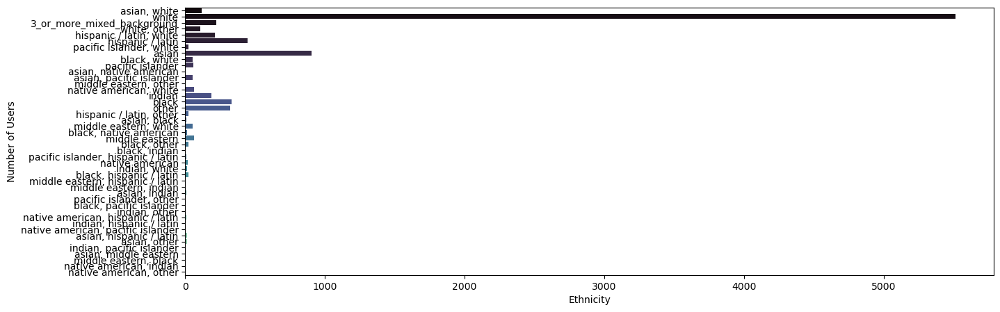

In [894]:
profiles3['ethnicity'] = profiles['ethnicity'].apply(lambda x: '3_or_more_mixed_background' if (str(x).count(',')>=2 ) else x)
plt.figure(figsize = (15,5))
sns.countplot(data = profiles3, y = 'ethnicity', palette = 'mako')
plt.xlabel('Ethnicity')
plt.ylabel('Number of Users')



In [895]:
profiles3.income.value_counts()

income
20000      2566
100000     1414
80000       946
30000       906
40000       860
50000       841
60000       645
70000       609
150000      558
1000000     411
250000      119
500000       37
Name: count, dtype: int64

#### Dummy variables

Next, dummy variables are created to deal with the categorical variables. Dummy variables will turn the categories per variable into its own binary identifier. The data now has 47 columns to predict body type. 

In [896]:
features = ['sex', 'age_interval', 'job', 'education', 'ethnicity',  'county']

profiles3 = profiles3[['income', 'sex', 'age_interval', 'job', 'education', 'ethnicity',  'county']]
 
for feature in features:
    profiles3 = pd.get_dummies(profiles3, columns=[feature], prefix = [feature], dtype=int)
profiles3.shape

(9912, 115)

### Addressing Imbalance of dataset

### Split the data

To address the imbalance of the data set we will use SMOTE: Synthetic Minority Over-sampling Technique. For body type we will compare model using SMOTE with another method combining undersampling and oversampling. SMOTE is implemented afer the data is split in the following way: 25% of the data is reserved for the final validation, while 75% is kept for training the model. 

In [977]:

#Y is the target column, X has the rest
x = profiles3.iloc[:,1:len(profiles3.columns)]
y = profiles3.iloc[:,0:1]

#Validation chunk size
val_size = 0.25

#Split the data into chunks
from sklearn.model_selection import train_test_split 
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=val_size, random_state = 0)

#turn in to 1d arrays
y_train = y_train.to_numpy().ravel()
y_test = y_test.to_numpy().ravel()

Class=6, n=1893 (3.130%)
Class=4, n=1893 (3.130%)
Class=0, n=1893 (3.130%)
Class=8, n=1893 (3.130%)
Class=1, n=1893 (3.130%)
Class=7, n=1893 (3.130%)
Class=9, n=1893 (3.130%)
Class=11, n=1893 (3.130%)
Class=5, n=1893 (3.130%)
Class=3, n=1893 (3.130%)
Class=2, n=1893 (3.130%)
Class=10, n=1893 (3.130%)


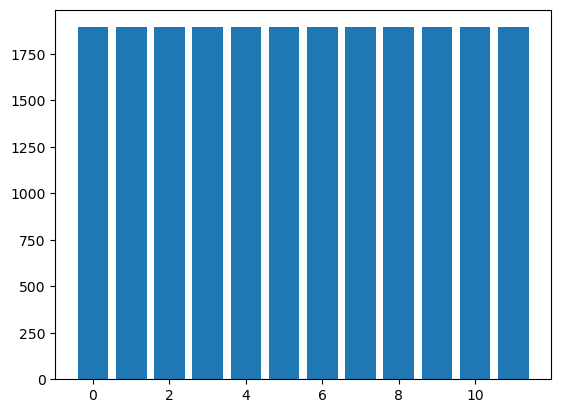

In [979]:
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.preprocessing import LabelEncoder

y_test_labeled = LabelEncoder().fit_transform(y_test)

y_train_labeled = LabelEncoder().fit_transform(y_train)

# transform the dataset
oversample = SMOTE()
x_train_SMOTE, y_train_SMOTE = oversample.fit_resample(x_train, y_train_labeled)
# summarize distribution
counter = Counter(y_train_SMOTE)
for k,v in counter.items():
 per = v / len(Y_train_SMOTE) * 100
 print('Class=%d, n=%d (%.3f%%)' % (k, v, per))
# plot the distribution
plt.bar(counter.keys(), counter.values())
plt.show()

## Prediction

### Model building

We will use support vector classification and logistic regression to predict the income. For the second part of this project we will explore other methods. 

#### SVC

We test different values of gamma and c to find the optimal hyperparametes.The highest accuracy of 36% is obtained with gamma = 0.1 and c = 100. 

In [981]:
 from sklearn.svm import SVC
 # Fitting Models variating Hyperparameters Gamma and C

scores = {}
gammac = []
for gamma in np.logspace(-3,2,6).tolist():
    for c in np.logspace(-3,2,6).tolist():
        gammac.append((gamma,c))
        svm = SVC(gamma = gamma, C = c)
        svm.fit(x_train_SMOTE, y_train_SMOTE)
        score = svm.score(x_test, y_test_labeled)
        scores[(gamma,c)] = score

gammas = [x[0] for x in scores.keys()]
cs = [x[1] for x in scores.keys()]
scores = list(scores.values())

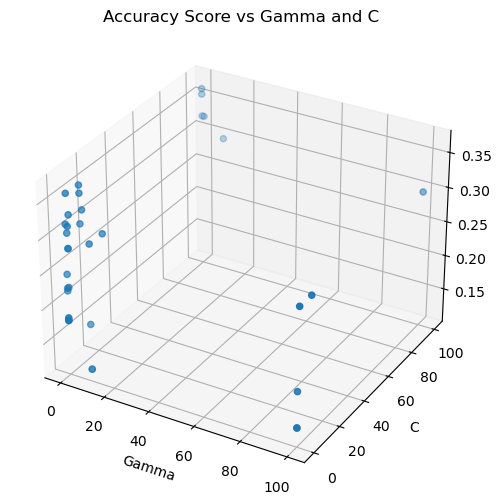

Best Accuracy Score: 0.3635996771589992
Best Gamma: 0.01
Best C: 100.0


<Figure size 640x480 with 0 Axes>

In [982]:
# 3D Plot
fig = plt.figure(figsize = (8,6))
ax = fig.add_subplot(projection = '3d')
ax.scatter(gammas, cs , scores)
plt.title('Accuracy Score vs Gamma and C')
plt.xlabel('Gamma')
plt.ylabel('C')
plt.show()

plt.show()
plt.clf()

# Best Combination for (Gamma, C)
best_score = max(scores)
best_index = scores.index(best_score)
best_gamma = gammas[best_index]
best_C = cs[best_index]

print(f'Best Accuracy Score: {best_score}' )
print(f'Best Gamma: {best_gamma}' )
print(f'Best C: {best_C}' )

In [984]:
# Applying best parameters and calculating Scores and metric 
from sklearn.metrics import classification_report

best_svc = SVC(gamma = best_gamma, C = best_C) 
best_svc.fit(x_train_SMOTE, y_train_SMOTE)
y_pred = best_svc.predict(x_test)
print(classification_report(y_test_labeled, y_pred, zero_division=0))

              precision    recall  f1-score   support

           0       0.57      0.79      0.66       673
           1       0.20      0.11      0.14       237
           2       0.19      0.17      0.18       197
           3       0.15      0.16      0.15       212
           4       0.08      0.03      0.05       153
           5       0.09      0.05      0.07       161
           6       0.25      0.19      0.21       248
           7       0.33      0.55      0.41       321
           8       0.35      0.25      0.29       142
           9       0.14      0.06      0.09        33
          10       0.00      0.00      0.00         6
          11       0.18      0.06      0.09        95

    accuracy                           0.36      2478
   macro avg       0.21      0.20      0.19      2478
weighted avg       0.31      0.36      0.32      2478



#### Logistic Regression

The accuracy of the logistic regression model in the test set is 26% which is lower than the one obtained using SVC.

In [985]:
from sklearn.linear_model import LogisticRegression

lgr_model_SMOTE = LogisticRegression(multi_class="multinomial", max_iter=500).fit(x_train_SMOTE, y_train_SMOTE)
lgr_predictions_SMOTE = lgr_model_SMOTE.predict(x_train_SMOTE)
print(classification_report(y_train_SMOTE, lgr_predictions_SMOTE, zero_division=0))

              precision    recall  f1-score   support

           0       0.58      0.78      0.67      1893
           1       0.31      0.27      0.29      1893
           2       0.26      0.16      0.20      1893
           3       0.26      0.16      0.20      1893
           4       0.30      0.17      0.22      1893
           5       0.23      0.17      0.19      1893
           6       0.25      0.15      0.18      1893
           7       0.34      0.51      0.40      1893
           8       0.34      0.36      0.35      1893
           9       0.42      0.56      0.48      1893
          10       0.59      0.83      0.69      1893
          11       0.33      0.44      0.38      1893

    accuracy                           0.38     22716
   macro avg       0.35      0.38      0.35     22716
weighted avg       0.35      0.38      0.35     22716



A cross validation of the logistic regression shows a baseline of 36.4% which is very close to the 38% obtained when we train the data above. After predicting the test data we get 36% accuracy which indicates that our model is performing similar when it is applied to other data sets.

In [986]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
kfold = KFold(n_splits=5, shuffle=True, random_state=0)
results_lgr_SMOTE = cross_val_score(lgr_model_SMOTE, x_train_SMOTE, y_train_SMOTE, cv=kfold, scoring='accuracy')
print(results_lgr_SMOTE)
print("Baseline: %.2f%% (%.2f%%)" % (results_lgr_SMOTE.mean()*100, results_lgr_SMOTE.std()*100))

[0.36421655 0.36539731 0.36825886 0.35637244 0.36583755]
Baseline: 36.40% (0.40%)


In [988]:
lgr_predictions_test_SMOTE = lgr_model_SMOTE.predict(x_test)
print(classification_report(y_test_labeled, lgr_predictions_test_SMOTE, zero_division=0))

              precision    recall  f1-score   support

           0       0.60      0.72      0.65       673
           1       0.16      0.11      0.13       237
           2       0.18      0.13      0.15       197
           3       0.18      0.17      0.18       212
           4       0.12      0.06      0.08       153
           5       0.08      0.05      0.06       161
           6       0.24      0.16      0.19       248
           7       0.34      0.63      0.44       321
           8       0.34      0.29      0.31       142
           9       0.00      0.00      0.00        33
          10       0.00      0.00      0.00         6
          11       0.12      0.13      0.12        95

    accuracy                           0.36      2478
   macro avg       0.20      0.20      0.19      2478
weighted avg       0.31      0.36      0.32      2478



### Final model

Both methos applied to predict income give similar accuracy scores of 36%. However, the accuracy is considered low which could be fixed with a more detailed tuning of the hyperparameters could lead to better results. 

# Body type prediction

For the body_prediction we will use the profiles2 data frame to focus in Californian users as in the previous case. We have 12 predictions which is an OK amount.  

In [897]:
print("Number of categories:",profiles2.body_type.nunique())
print("Categories:", profiles2.body_type.unique())

profiles2.body_type.value_counts()

Number of categories: 12
Categories: ['a little extra' 'average' 'thin' 'athletic' 'fit' nan 'skinny' 'curvy'
 'full figured' 'jacked' 'rather not say' 'used up' 'overweight']


body_type
average           14627
fit               12693
athletic          11797
thin               4710
curvy              3917
a little extra     2627
skinny             1774
full figured       1008
overweight          444
jacked              418
used up             353
rather not say      198
Name: count, dtype: int64

Here will not compare with the complete data set as we have only lost less that 0.2 so it is expected to have a similar category distribution.

<Axes: xlabel='count', ylabel='body_type'>

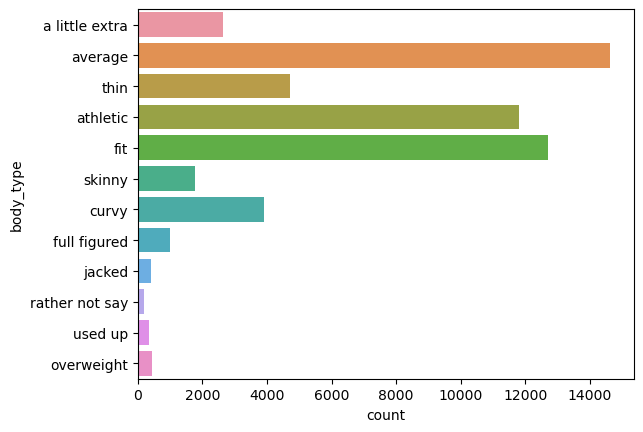

In [898]:
sns.countplot(data=profiles2, y ='body_type')

#### Sex

We will use the column `sex` as before. 

In [899]:
profiles2.sex.value_counts()

sex
m    35768
f    24087
Name: count, dtype: int64

#### Age

Then let us inspect the `age` column. We can see that there are 2 users with more than 100 years. However, their columns have mostly `nan` values. Before (income section) we did not encounter them as they were removed when we group the cities by county.

In [900]:
profiles2.age.value_counts()

age
26     3720
27     3679
28     3572
25     3526
29     3285
24     3239
30     3142
31     2732
23     2591
32     2585
33     2201
22     1926
34     1900
35     1753
36     1582
37     1425
38     1328
21     1279
39     1171
42     1069
40     1029
41      980
20      951
43      857
44      708
45      642
19      611
46      577
47      529
48      481
49      459
50      437
51      350
52      343
18      307
56      271
54      267
55      265
57      256
53      252
59      220
58      197
60      195
61      176
62      167
63      138
64      113
65      109
66      105
67       66
68       59
69       31
110       1
109       1
Name: count, dtype: int64

In [901]:
profiles2[profiles2['age'] >70]

,age,body_type,diet,drinks,drugs,education,essay0,essay1,essay2,essay3,...,pets,religion,sex,sign,smokes,speaks,status,location_by_state_or_country,city,county
2512,110,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,f,NaN,NaN,english,single,california,daly city,san mateo
25324,109,athletic,mostly other,NaN,never,working on masters program,NaN,NaN,NaN,nothing,...,NaN,other and somewhat serious about it,m,aquarius but it doesn&rsquo;t matter,when drinking,english (okay),available,california,san francisco,san francisco


We will proceed to remove all the rows with `nan` values in the columns `age`, `sex`, `diet`, `drinks`, `smokes`, `drugs`, `body_type`, before we group the `age` column in intervals. 

In [902]:
cols2 = ['age', 'sex', 'diet', 'drinks', 'smokes', 'drugs', 'body_type', 'height']
profiles2 = profiles2[cols2].dropna().reset_index()
profiles2.shape

(25160, 9)

In [903]:
profiles2['age_interval'] = 'none'
profiles2.loc[profiles2.age.isin([18, 19, 20, 21, 22]), 'age_interval'] = '18-22'
profiles2.loc[profiles2.age.isin([23, 24, 25, 26, 27]), 'age_interval'] = '23-27'
profiles2.loc[profiles2.age.isin([27, 28, 29, 30, 31]), 'age_interval'] = '28-31'
profiles2.loc[profiles2.age.isin([32, 33, 34, 35, 36]), 'age_interval'] = '32-36'
profiles2.loc[profiles2.age.isin([37, 38, 39, 40, 41]), 'age_interval'] = '37-41' 
profiles2.loc[profiles2.age.isin([42, 43, 44, 45, 46]), 'age_interval'] = '42-46'
profiles2.loc[profiles2.age.isin([47, 48, 49, 50, 51]), 'age_interval'] = '47-51'
profiles2.loc[profiles2.age.isin([52, 53, 54, 55, 56]), 'age_interval'] = '52-56'
profiles2.loc[profiles2.age.isin([57, 58, 59, 60, 61]), 'age_interval'] = '57-61' 
profiles2.loc[profiles2.age.isin([62, 63, 64, 65, 66]), 'age_interval'] = '62-66'
profiles2.loc[profiles2.age.isin([67, 68, 69, 70, 71]), 'age_interval'] = '67-71'

profiles2.age_interval.value_counts()

age_interval
28-31    6614
23-27    5584
32-36    3970
18-22    2491
37-41    2366
42-46    1589
47-51     986
52-56     659
57-61     511
62-66     314
67-71      76
Name: count, dtype: int64

After removing the users that did not provide information in the columns that will be used to predict the body type of an user. Most of the users are in their late 20's and early 30's, similar to the distribution if we consider the complete dataset.

<Axes: xlabel='count', ylabel='age_interval'>

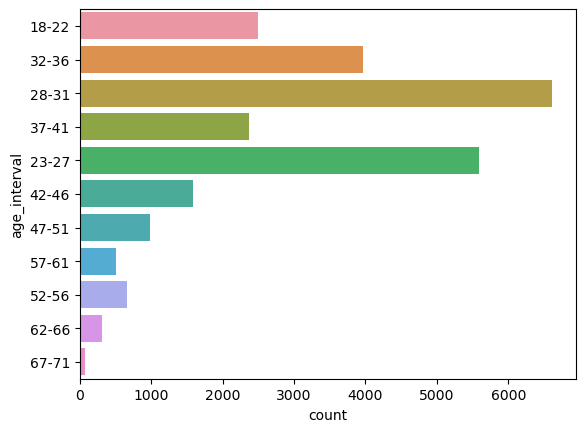

In [904]:
sns.countplot(data=profiles2, y='age_interval')

#### Diet

Next consider the `diet` column. We can see that there are 17 categories but we can combine some of them, for instance, 'strictly vegan' and 'vegan'.

In [905]:
print("Number of categories:",profiles2.diet.nunique())
print("Categories:", profiles2.diet.unique())

profiles2.diet.value_counts()

Number of categories: 18
Categories: ['strictly anything' 'mostly other' 'mostly anything' 'mostly vegetarian'
 'strictly vegan' 'anything' 'vegetarian' 'mostly halal'
 'strictly vegetarian' 'other' 'strictly other' 'vegan' 'mostly vegan'
 'mostly kosher' 'strictly halal' 'halal' 'strictly kosher' 'kosher']


diet
mostly anything        12273
anything                4350
strictly anything       3337
mostly vegetarian       2319
mostly other             738
strictly vegetarian      631
vegetarian               364
strictly other           308
other                    233
mostly vegan             220
strictly vegan           159
vegan                     86
mostly kosher             64
mostly halal              36
strictly halal            15
strictly kosher           14
halal                      7
kosher                     6
Name: count, dtype: int64

Most of the users eat 'anything' or 'mostly anything' and we have a similar distribution of the categories as if we consider the complete dataset. 

In [906]:
profiles2['diet_type'] =  profiles2.diet.replace('strictly anything', 'anything').replace('strictly halal', 'halal')\
                         .replace('strictly vegan', 'vegan').replace('strictly vegetarian', 'vegetarian').replace('strictly kosher', 'kosher')\
                         .replace('strictly other', 'other')

profiles2.diet_type.value_counts()

diet_type
mostly anything      12273
anything              7687
mostly vegetarian     2319
vegetarian             995
mostly other           738
other                  541
vegan                  245
mostly vegan           220
mostly kosher           64
mostly halal            36
halal                   22
kosher                  20
Name: count, dtype: int64

<Axes: xlabel='count', ylabel='diet_type'>

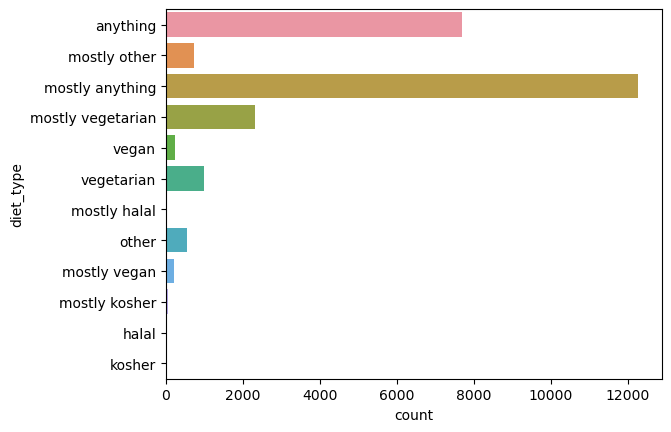

In [907]:
sns.countplot(data=profiles2, y='diet_type')

<Axes: xlabel='count', ylabel='diet'>

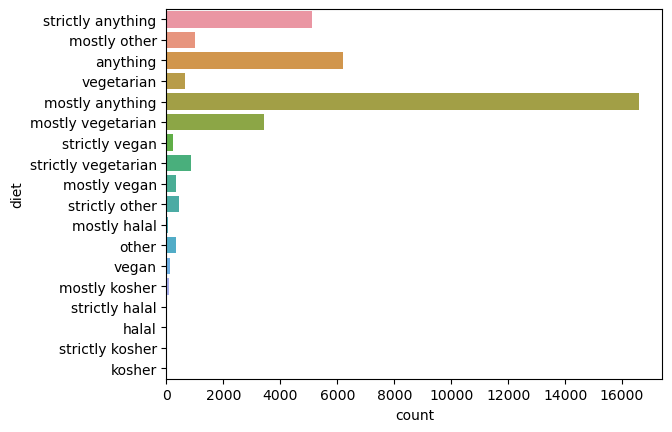

In [908]:
sns.countplot(data=profiles, y='diet')

#### Drugs

The `drugs` column has 3 categories, namely, 'never', 'sometimes' and 'often'. In the section of the dataset chosen to predict the body type, it can be seen that most of the users have never consumed drugs and the distribution of the categories is similar to the one of the complete dataset. 

In [909]:
print("Number of categories:",profiles2.drugs.nunique())
print("Categories:", profiles2.drugs.unique())

profiles2.drugs.value_counts()

Number of categories: 3
Categories: ['never' 'sometimes' 'often']


drugs
never        20305
sometimes     4593
often          262
Name: count, dtype: int64

<Axes: xlabel='count', ylabel='drugs'>

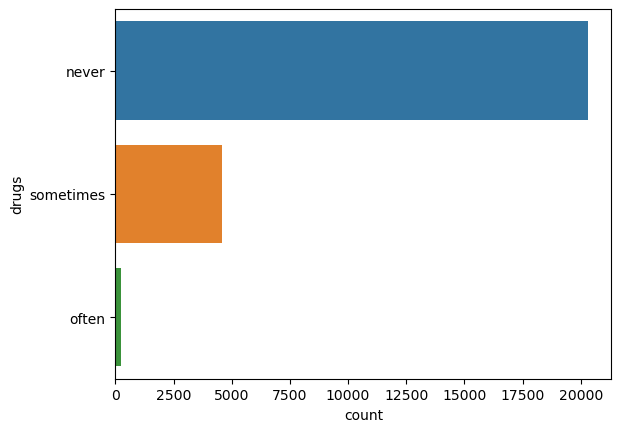

In [910]:
sns.countplot(data=profiles2, y='drugs')

<Axes: xlabel='count', ylabel='drugs'>

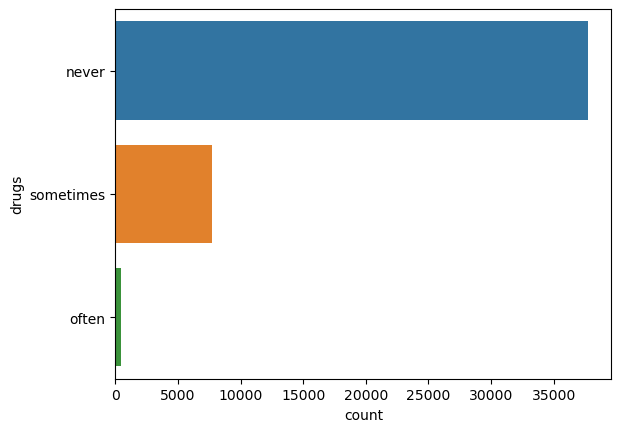

In [911]:
sns.countplot(data=profiles, y='drugs')

#### Smokes

The `smokes` column does not need any manipulation. It has 5 categories with 'no' being the most common one by far. Also we have the same distribution of the categories as if we consider the complete dataset.

In [912]:
print("Number of categories:",profiles2.smokes.nunique())
print("Categories:", profiles2.smokes.unique())

profiles2.smokes.value_counts()

Number of categories: 5
Categories: ['sometimes' 'no' 'trying to quit' 'when drinking' 'yes']


smokes
no                20369
sometimes          1683
when drinking      1425
yes                1032
trying to quit      651
Name: count, dtype: int64

<Axes: xlabel='count', ylabel='smokes'>

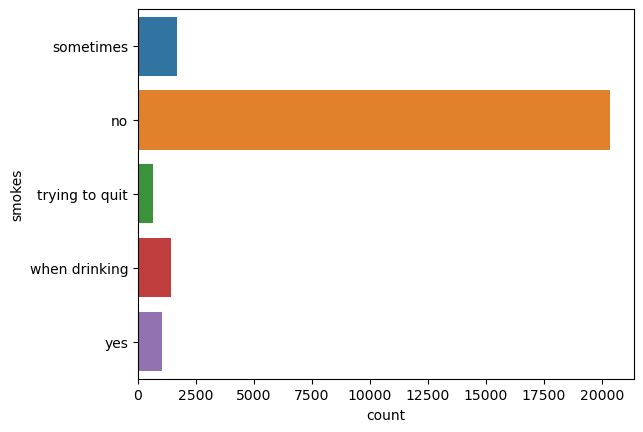

In [913]:
sns.countplot(data=profiles2, y='smokes')

<Axes: xlabel='count', ylabel='smokes'>

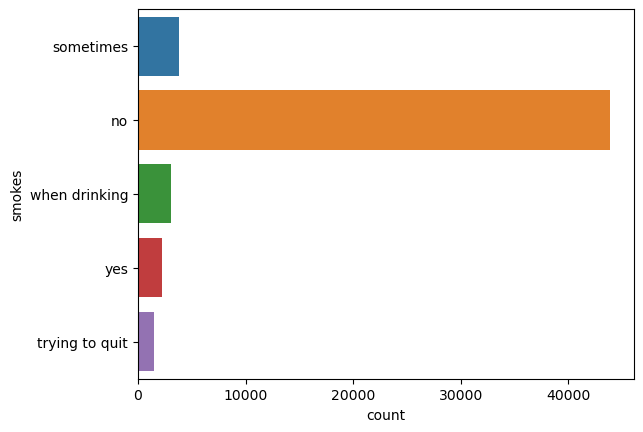

In [914]:
sns.countplot(data=profiles, y='smokes')

#### Drinks

Similarly, for the `drinks` columns, no action is required. It has 6 categories, 'socially' is the largest category and the distribution of the categoires resembles the one exhibited by the complete dataset.

In [915]:
print("Number of categories:",profiles2.drinks.nunique())
print("Categories:", profiles2.drinks.unique())

profiles2.drinks.value_counts()

Number of categories: 6
Categories: ['socially' 'often' 'not at all' 'rarely' 'very often' 'desperately']


drinks
socially       17900
rarely          2890
often           2159
not at all      1787
very often       263
desperately      161
Name: count, dtype: int64

<Axes: xlabel='count', ylabel='drinks'>

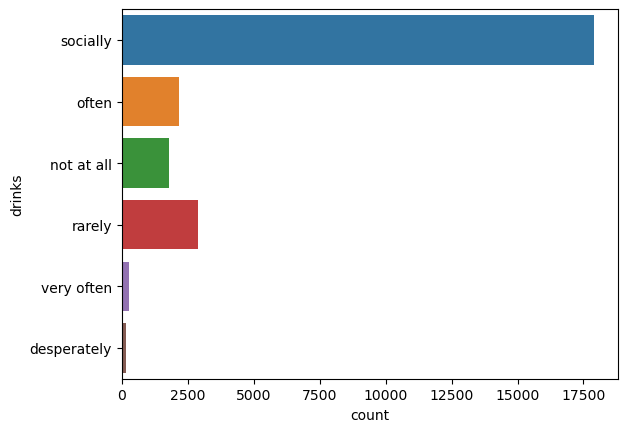

In [916]:
sns.countplot(data=profiles2, y='drinks')

<Axes: xlabel='count', ylabel='drinks'>

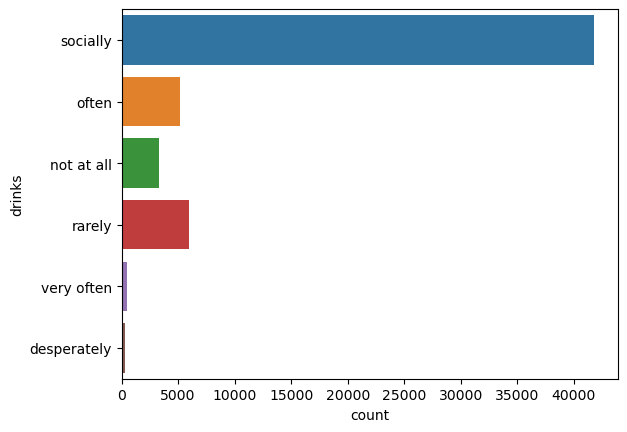

In [917]:
sns.countplot(data=profiles, y='drinks')

#### Height

The `height` column is another feature that may help predict the body type of an user. However, since the values are provided without a unit system, it is a bit problematic since we have values going from 9 to 95. We will assume that the values are given in inches since the data is for american users, then we will remove the values that simply make no sense, i.e. those below 42 inches (less than 1.07 m) and those above 85. Most of the users are in the range 67-71 inches. 

In [918]:
print("Number of categories:",profiles2.height.nunique())
print("Categories:", profiles2.height.unique())

profiles2.height.value_counts()

Number of categories: 42
Categories: [75. 70. 65. 72. 66. 62. 71. 67. 69. 73. 60. 68. 61. 64. 74. 63. 79. 59.
 80. 76. 91. 83. 77. 56. 58. 57. 78. 87. 81. 36. 43. 55. 53. 54. 82. 95.
 84. 47. 48. 94.  9. 85.]


height
70.0    2525
67.0    2276
68.0    2257
72.0    2193
69.0    2145
66.0    2000
71.0    1992
65.0    1651
64.0    1637
73.0    1216
63.0    1162
74.0    1051
62.0     950
75.0     615
61.0     441
76.0     338
60.0     325
77.0     123
59.0      96
78.0      52
79.0      24
58.0      21
80.0      15
82.0       7
95.0       6
81.0       6
83.0       5
56.0       5
57.0       4
36.0       3
55.0       3
43.0       2
53.0       2
54.0       2
91.0       2
94.0       2
87.0       1
84.0       1
47.0       1
48.0       1
9.0        1
85.0       1
Name: count, dtype: int64

In [919]:
profiles2 = profiles2[profiles2['height'] < 86]
profiles2 = profiles2[profiles2['height'] > 36]
profiles2.shape

(25145, 11)

In [920]:
profiles2['height_interval'] = 'none'
profiles2.loc[profiles2.height.isin([42, 43, 44, 45, 46]), 'height_interval'] = '42-46'
profiles2.loc[profiles2.height.isin([47, 48, 49, 50, 51]), 'height_interval'] = '47-51'
profiles2.loc[profiles2.height.isin([52, 53, 54, 55, 56]), 'height_interval'] = '52-56'
profiles2.loc[profiles2.height.isin([57, 58, 59, 60, 61]), 'height_interval'] = '57-61'
profiles2.loc[profiles2.height.isin([62, 63, 64, 65, 66]), 'height_interval'] = '62-66' 
profiles2.loc[profiles2.height.isin([67, 68, 69, 70, 71]), 'height_interval'] = '67-71'
profiles2.loc[profiles2.height.isin([72, 73, 74, 75, 76]), 'height_interval'] = '72-76'
profiles2.loc[profiles2.height.isin([77, 78, 79, 80, 81]), 'height_interval'] = '77-81'
profiles2.loc[profiles2.height.isin([82, 83, 84, 85]), 'height_interval'] = '82-85' 
#profiles2 = profiles2[profiles2.height_interval != 'none']

profiles2.height_interval.value_counts()

height_interval
67-71    11195
62-66     7400
72-76     5413
57-61      887
77-81      220
82-85       14
52-56       12
42-46        2
47-51        2
Name: count, dtype: int64

<Axes: xlabel='count', ylabel='height_interval'>

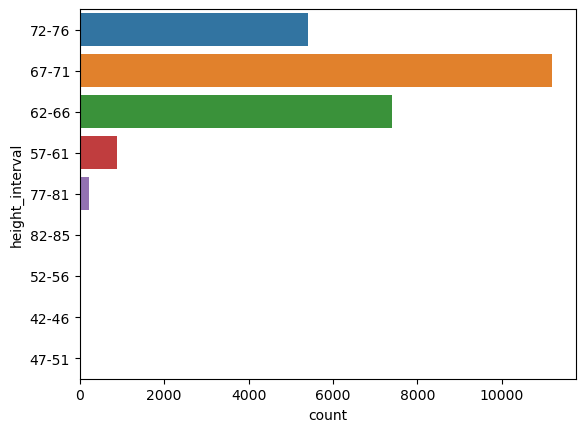

In [921]:
sns.countplot(data=profiles2, y='height_interval')

#### Dummy variables

In this next step, dummy variables are created to deal with the categorical variables. Dummy variables will turn the categories per variable into its own binary identifier. The data now has 47 columns to predict body type. 

In [922]:
features2 = ['sex', 'age_interval', 'smokes', 'drinks', 'drugs', 'diet_type', 'height_interval']

profiles2 = profiles2[['body_type','sex', 'age_interval', 'smokes', 'drinks', 'drugs', 'diet_type', 'height_interval']]
 
for feature in features2:
    profiles2 = pd.get_dummies(profiles2, columns=[feature], prefix = [feature], dtype=int)
profiles2.shape

(25145, 49)

In [923]:
profiles2.head()

,body_type,sex_f,sex_m,age_interval_18-22,age_interval_23-27,age_interval_28-31,age_interval_32-36,age_interval_37-41,age_interval_42-46,age_interval_47-51,...,diet_type_vegetarian,height_interval_42-46,height_interval_47-51,height_interval_52-56,height_interval_57-61,height_interval_62-66,height_interval_67-71,height_interval_72-76,height_interval_77-81,height_interval_82-85
0,a little extra,0,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
1,average,0,1,0,0,0,1,0,0,0,...,0,0,0,0,0,0,1,0,0,0
2,average,1,0,0,0,1,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
3,athletic,0,1,0,0,0,0,1,0,0,...,0,0,0,0,0,1,0,0,0,0
4,average,0,1,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [924]:
profiles2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25145 entries, 0 to 25159
Data columns (total 49 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   body_type                    25145 non-null  object
 1   sex_f                        25145 non-null  int32 
 2   sex_m                        25145 non-null  int32 
 3   age_interval_18-22           25145 non-null  int32 
 4   age_interval_23-27           25145 non-null  int32 
 5   age_interval_28-31           25145 non-null  int32 
 6   age_interval_32-36           25145 non-null  int32 
 7   age_interval_37-41           25145 non-null  int32 
 8   age_interval_42-46           25145 non-null  int32 
 9   age_interval_47-51           25145 non-null  int32 
 10  age_interval_52-56           25145 non-null  int32 
 11  age_interval_57-61           25145 non-null  int32 
 12  age_interval_62-66           25145 non-null  int32 
 13  age_interval_67-71           25145 n

#### Addressing imbalanced data

After choosing the features and cleaning the data, the size of the set consists of 25145 rows which is enough to construct a model. It is important to mention that there is potentially bias arising from our `ethnicity` and `height` filter process. Also, despite trying to resemble the ditribution of the categories of the full data set in the section picked to predict the body type, the sample might not represent the full diversity of the OKCupid users.

In [925]:
profiles2.body_type.value_counts()

body_type
average           6789
fit               5730
athletic          5352
thin              2190
curvy             1838
a little extra    1311
skinny             803
full figured       463
overweight         225
jacked             187
used up            179
rather not say      78
Name: count, dtype: int64

### Split the data

To address the imbalance of the data set we will use two methods, the first is SMOTE: Synthetic Minority Over-sampling Technique and the other will be a more naive and simple random oversampling and undersampling using the resample method of sklearn. 

One can perform these techniques before or after the split of the data into training and test sets, as long as they are implemented only on the training set. For both approaches the methods will be implemented after the data is split in the following way: 25% of the data is reserved for the final validation, while 75% is kept for training the model. 

##### SMOTE

In [926]:

#Y is the target column, X has the rest
X = profiles2.iloc[:,1:len(profiles2.columns)]
Y = profiles2.iloc[:,0:1]

#Validation chunk size
val_size = 0.25

#Split the data into chunks
from sklearn.model_selection import train_test_split 
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=val_size, random_state = 0)

#turn in to 1d arrays
Y_train = Y_train.to_numpy().ravel()
Y_test = Y_test.to_numpy().ravel()

Class=4, n=5040 (8.333%)
Class=2, n=5040 (8.333%)
Class=1, n=5040 (8.333%)
Class=5, n=5040 (8.333%)
Class=3, n=5040 (8.333%)
Class=0, n=5040 (8.333%)
Class=7, n=5040 (8.333%)
Class=10, n=5040 (8.333%)
Class=9, n=5040 (8.333%)
Class=6, n=5040 (8.333%)
Class=11, n=5040 (8.333%)
Class=8, n=5040 (8.333%)


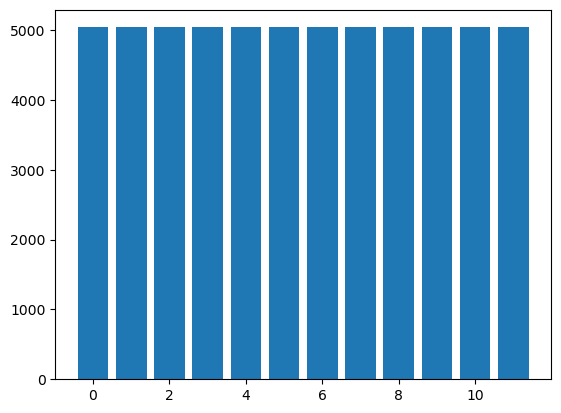

In [927]:
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.preprocessing import LabelEncoder

Y_test_labeled = LabelEncoder().fit_transform(Y_test)

Y_train_labeled = LabelEncoder().fit_transform(Y_train)

# transform the dataset
oversample = SMOTE()
X_train_SMOTE, Y_train_SMOTE = oversample.fit_resample(X_train, Y_train_labeled)
# summarize distribution
counter = Counter(Y_train_SMOTE)
for k,v in counter.items():
 per = v / len(Y_train_SMOTE) * 100
 print('Class=%d, n=%d (%.3f%%)' % (k, v, per))
# plot the distribution
plt.bar(counter.keys(), counter.values())
plt.show()



Encoder map is based on alphabetic order\
0 ---> a little extra\
1 ---> athletic\
2 ---> average\
3 ---> curvy\
4 ---> fit\
5 ---> full figured\
6 ---> jacked\
7 ---> overweight\
8 ---> rather not say\
9 ---> skinny\
10 ---> thin\
11 ---> used up

#### Oversampling and downsampling 

In [928]:
# Oversampling Minority Classes and DownSampling Majority Ones
from sklearn.utils import resample

training, test = train_test_split(profiles2, test_size=val_size, random_state = 0)

training_majority_class = training[training['body_type'] == 'average']
training_class2 = training[training['body_type'] == 'fit']
training_class3 = training[training['body_type'] == 'athletic']
training_class4 = training[training['body_type'] == 'thin']
training_class5 = training[training['body_type']== 'curvy']
training_class6 = training[training['body_type'] == 'a little extra']
training_class7 = training[training['body_type'] =='skinny']
training_class8 = training[training['body_type'] =='full figured']
training_class9 = training[training['body_type'] =='overweight']
training_class10 = training[training['body_type'] =='jacked']
training_class11 = training[training['body_type']=='used up']
training_minority_class = training[training['body_type'] =='rather not say']

# DownSampling Majority Classes to 1000 samples
training_majority_class_dnsample = resample(training_majority_class, replace = False, n_samples = 1000, random_state = 96)

#DownSampling and Oversampling Remaining Classes
training_class2_dnsample = resample(training_class2, replace = False, n_samples =1000, random_state = 88)
training_class3_dnsample = resample(training_class3, replace = False, n_samples =1000, random_state = 80)
training_class4_dnsample = resample(training_class4, replace = False, n_samples =1000, random_state = 72)
training_class5_dnsample = resample(training_class5, replace = False, n_samples =1000, random_state = 64)
training_class6_upsample = resample(training_class6, replace = True, n_samples =1000, random_state = 56)
training_class7_upsample = resample(training_class7, replace = True, n_samples =1000, random_state = 48)
training_class8_upsample = resample(training_class8, replace = True, n_samples =1000, random_state = 40)
training_class9_upsample = resample(training_class9, replace = True, n_samples =1000, random_state = 32)
training_class10_upsample = resample(training_class10, replace = True, n_samples =1000, random_state = 24)
training_class11_upsample = resample(training_class11, replace = True, n_samples =1000, random_state = 16)

# OverSampling Minority Classes to 1000 samples
training_minority_class_upsample = resample(training_minority_class, replace = True, n_samples = 1000, random_state = 8)

# Combining results in new DataFrame
training_balanced = pd.concat([training_majority_class_dnsample, training_class2_dnsample, training_class3_dnsample, training_class4_dnsample, \
                               training_class5_dnsample, training_class6_upsample, training_class7_upsample, training_class8_upsample, \
                               training_class9_upsample, training_class10_upsample, training_class11_upsample, training_minority_class_upsample])
training_balanced['body_type'].value_counts()

X_train_2 = training_balanced.iloc[:,1:len(profiles2.columns)]
Y_train_2 = training_balanced.iloc[:,0:1]
Y_train_2 = Y_train_2.to_numpy().ravel()
X_test_2 = test.iloc[:,1:len(profiles2.columns)]
Y_test_2 = test.iloc[:,0:1]
Y_test_2 =Y_test_2.to_numpy().ravel()



### Prediction

#### Model building 

For this project three common algorithms will be used to make predictions. Below, the respective modules for Logistic Regression, KNN, Decision Trees and Random Forests are loaded. In addition, for each type of classification model, we will compare the results obtained using our two methods to address the imbalance of the data and a model where no modication to fix such imbalance was done.

In [929]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier

#### Logistic Regression

The Logistic regresson implementing SMOTE gives the highest accuracy of 26% but it is low. Note that if we do not adress the imbalance of the prediction classes, we cannot compute some metrics for certain classes as they are ill definided (zero division) and despite reporting a higher accuracy of 30%, it cannot be reliable. 

##### Implementing SMOTE to fix the imbalance of the data

In [930]:
lr_model_SMOTE = LogisticRegression(multi_class="multinomial", max_iter=500).fit(X_train_SMOTE, Y_train_SMOTE)
lr_predictions_SMOTE = lr_model_SMOTE.predict(X_train_SMOTE)

In [931]:
print(classification_report(Y_train_SMOTE, lr_predictions_SMOTE, zero_division=0))

              precision    recall  f1-score   support

           0       0.38      0.10      0.16      5040
           1       0.27      0.55      0.36      5040
           2       0.28      0.20      0.24      5040
           3       0.29      0.74      0.41      5040
           4       0.30      0.12      0.18      5040
           5       0.35      0.43      0.39      5040
           6       0.31      0.25      0.28      5040
           7       0.40      0.30      0.35      5040
           8       0.46      0.71      0.56      5040
           9       0.37      0.20      0.26      5040
          10       0.14      0.00      0.01      5040
          11       0.46      0.50      0.48      5040

    accuracy                           0.34     60480
   macro avg       0.33      0.34      0.31     60480
weighted avg       0.33      0.34      0.31     60480



A cross validation of the logistic regression shows a baseline of 33.63% which is very close to the 34% obtained when we train the data above. After predicting the test data we get 26% accuracy which is not drastically lower.

In [932]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
kfold = KFold(n_splits=5, shuffle=True, random_state=0)
results_lr_SMOTE = cross_val_score(lr_model_SMOTE, X_train_SMOTE, Y_train_SMOTE, cv=kfold, scoring='accuracy')
print(results_lr_SMOTE)
print("Baseline: %.2f%% (%.2f%%)" % (results_lr_SMOTE.mean()*100, results_lr_SMOTE.std()*100))

[0.34011243 0.33424272 0.33788029 0.33482143 0.33978175]
Baseline: 33.74% (0.24%)


In [933]:
lr_predictions_test_SMOTE = lr_model_SMOTE.predict(X_test)
print(classification_report(Y_test_labeled, lr_predictions_test_SMOTE, zero_division=0))

              precision    recall  f1-score   support

           0       0.27      0.01      0.02       319
           1       0.31      0.55      0.40      1327
           2       0.32      0.18      0.23      1749
           3       0.19      0.82      0.31       478
           4       0.28      0.12      0.16      1415
           5       0.07      0.06      0.06       107
           6       0.00      0.00      0.00        42
           7       0.00      0.00      0.00        51
           8       0.00      0.00      0.00        23
           9       0.08      0.04      0.05       183
          10       0.17      0.01      0.02       554
          11       0.08      0.05      0.06        39

    accuracy                           0.26      6287
   macro avg       0.15      0.15      0.11      6287
weighted avg       0.26      0.26      0.22      6287



##### Oversampling and downsampling

In [934]:
lr_model_up_dn_sampling = LogisticRegression(multi_class="multinomial", max_iter=500).fit(X_train_2, Y_train_2)
lr_predictions_up_dn_sampling = lr_model_up_dn_sampling.predict(X_train_2)

In [935]:
print(classification_report(Y_train_2, lr_predictions_up_dn_sampling, zero_division=0))

                precision    recall  f1-score   support

a little extra       0.26      0.12      0.17      1000
      athletic       0.18      0.36      0.24      1000
       average       0.17      0.02      0.03      1000
         curvy       0.21      0.60      0.31      1000
           fit       0.13      0.03      0.05      1000
  full figured       0.27      0.41      0.33      1000
        jacked       0.26      0.16      0.20      1000
    overweight       0.24      0.16      0.19      1000
rather not say       0.26      0.29      0.28      1000
        skinny       0.22      0.24      0.23      1000
          thin       0.22      0.02      0.03      1000
       used up       0.29      0.36      0.32      1000

      accuracy                           0.23     12000
     macro avg       0.23      0.23      0.20     12000
  weighted avg       0.23      0.23      0.20     12000



A cross validation of the logistic regression shows a baseline of 21.75% that is close to the accuracy score of 23% obtained above. After predicting the test data we get 15% accuracy which is not drastically lower.

In [936]:
kfold = KFold(n_splits=5, shuffle=True, random_state=0)
results_lr_up_dn_sampling = cross_val_score(lr_model_up_dn_sampling, X_train_2, Y_train_2, cv=kfold, scoring='accuracy')
print(results_lr_up_dn_sampling)
print("Baseline: %.2f%% (%.2f%%)" % (results_lr_up_dn_sampling.mean()*100, results_lr_up_dn_sampling.std()*100))

[0.2175     0.21583333 0.22041667 0.21208333 0.22083333]
Baseline: 21.73% (0.32%)


In [937]:
lr_predictions_test_up_dn_sampling = lr_model_up_dn_sampling.predict(X_test_2)
print(classification_report(Y_test_2, lr_predictions_test_up_dn_sampling, zero_division=0))

                precision    recall  f1-score   support

a little extra       0.11      0.10      0.10       319
      athletic       0.34      0.37      0.35      1327
       average       0.36      0.02      0.03      1749
         curvy       0.18      0.55      0.27       478
           fit       0.29      0.03      0.05      1415
  full figured       0.05      0.34      0.09       107
        jacked       0.03      0.17      0.05        42
    overweight       0.02      0.12      0.03        51
rather not say       0.01      0.13      0.01        23
        skinny       0.06      0.19      0.09       183
          thin       0.06      0.00      0.01       554
       used up       0.03      0.33      0.05        39

      accuracy                           0.15      6287
     macro avg       0.13      0.20      0.09      6287
  weighted avg       0.27      0.15      0.13      6287



##### Imbalanced dataset.

We will not cross validate the model as the accuracy score cannot be reliable for models where imbalance classes have not been addressed.

In [938]:
lr_model = LogisticRegression(multi_class="multinomial", max_iter=500).fit(X_train, Y_train)
lr_predictions = lr_model.predict(X_train)

In [939]:
print(classification_report(Y_train, lr_predictions, zero_division=0))

                precision    recall  f1-score   support

a little extra       0.00      0.00      0.00       992
      athletic       0.34      0.51      0.41      4025
       average       0.29      0.55      0.38      5040
         curvy       0.26      0.12      0.16      1360
           fit       0.31      0.19      0.23      4315
  full figured       0.00      0.00      0.00       356
        jacked       0.45      0.03      0.06       145
    overweight       0.00      0.00      0.00       174
rather not say       0.00      0.00      0.00        55
        skinny       0.50      0.00      0.01       620
          thin       0.13      0.00      0.01      1636
       used up       0.37      0.07      0.12       140

      accuracy                           0.31     18858
     macro avg       0.22      0.12      0.12     18858
  weighted avg       0.28      0.31      0.26     18858



#### K Nearest Neighbour KNN 

Comparing each model with their corresponding logistic regression model, we see that in general KNN models have lower accuracy. The one implementing SMOTE gives again the highest accuracy (19%) and some metrics cannot be computed in the model without addressing the imbalance of the prediction classes. The latter one, together with the fact that the accuracy for that model is 25% indicates that one cannot rely on the accuracy score for imbalance dataset. 

##### Implementing SMOTE to fix the imbalance of the data

In [940]:
knn_model_SMOTE = KNeighborsClassifier(n_neighbors = 5).fit(X_train_SMOTE.values, Y_train_SMOTE)
knn_predictions_SMOTE = knn_model_SMOTE.predict(X_train_SMOTE.values)

In [941]:
print(classification_report(Y_train_SMOTE, knn_predictions_SMOTE, zero_division=0))

              precision    recall  f1-score   support

           0       0.38      0.44      0.41      5040
           1       0.28      0.41      0.34      5040
           2       0.31      0.26      0.28      5040
           3       0.46      0.50      0.48      5040
           4       0.32      0.20      0.25      5040
           5       0.56      0.56      0.56      5040
           6       0.61      0.67      0.64      5040
           7       0.73      0.55      0.63      5040
           8       0.70      0.86      0.77      5040
           9       0.47      0.49      0.48      5040
          10       0.39      0.26      0.31      5040
          11       0.75      0.77      0.76      5040

    accuracy                           0.50     60480
   macro avg       0.50      0.50      0.49     60480
weighted avg       0.50      0.50      0.49     60480



A cross validation of the knn shows a baseline of 44.86% which is close to the 50% accuracy obtained in the train data. After predicting the test data we get 19% accuracy which is drastically lower. This may indicate that we overfit the data and our model cannot be generalise to other datasets.

In [942]:
kfold = KFold(n_splits=5, shuffle=True, random_state=0)
results_knn_SMOTE = cross_val_score(knn_model_SMOTE, X_train_SMOTE.values, Y_train_SMOTE, cv=kfold, scoring='accuracy')
print(results_knn_SMOTE)
print("Baseline: %.2f%% (%.2f%%)" % (results_knn_SMOTE.mean()*100, results_knn_SMOTE.std()*100))

[0.46023479 0.45155423 0.44527116 0.43625992 0.45345569]
Baseline: 44.94% (0.81%)


In [943]:
knn_predictions_test_SMOTE = knn_model_SMOTE.predict(X_test.values)
print(classification_report(Y_test_labeled, knn_predictions_test_SMOTE, zero_division=0))

              precision    recall  f1-score   support

           0       0.05      0.11      0.07       319
           1       0.27      0.32      0.29      1327
           2       0.28      0.17      0.21      1749
           3       0.20      0.33      0.25       478
           4       0.26      0.14      0.18      1415
           5       0.07      0.12      0.09       107
           6       0.02      0.05      0.03        42
           7       0.01      0.02      0.02        51
           8       0.00      0.00      0.00        23
           9       0.03      0.08      0.05       183
          10       0.11      0.10      0.10       554
          11       0.01      0.03      0.02        39

    accuracy                           0.19      6287
   macro avg       0.11      0.12      0.11      6287
weighted avg       0.22      0.19      0.20      6287



##### Oversampling and downsampling

In [944]:
knn_model_up_dn_sampling = KNeighborsClassifier(n_neighbors = 5).fit(X_train_2.values, Y_train_2)
knn_predictions_up_dn_sampling = knn_model_up_dn_sampling.predict(X_train_2.values)

In [945]:
print(classification_report(Y_train_2, knn_predictions_up_dn_sampling, zero_division=0))

                precision    recall  f1-score   support

a little extra       0.38      0.43      0.41      1000
      athletic       0.25      0.34      0.29      1000
       average       0.25      0.17      0.21      1000
         curvy       0.39      0.36      0.38      1000
           fit       0.26      0.19      0.22      1000
  full figured       0.48      0.57      0.52      1000
        jacked       0.55      0.67      0.60      1000
    overweight       0.62      0.68      0.65      1000
rather not say       0.72      0.68      0.70      1000
        skinny       0.38      0.44      0.41      1000
          thin       0.28      0.15      0.20      1000
       used up       0.72      0.73      0.72      1000

      accuracy                           0.45     12000
     macro avg       0.44      0.45      0.44     12000
  weighted avg       0.44      0.45      0.44     12000



A cross validation of the knn shows a baseline of 35.99% which is 10% that the one obtained above. After predicting the test data we get 14% accuracy which is drastically lower/ Therefore, we overfit the data and our model cannot be applied to other datasets.

In [946]:
kfold = KFold(n_splits=5, shuffle=True, random_state=0)
results_knn_up_dn_sampling = cross_val_score(knn_model_up_dn_sampling, X_train_2.values, Y_train_2, cv=kfold, scoring='accuracy')
print(results_knn_up_dn_sampling)
print("Baseline: %.2f%% (%.2f%%)" % (results_knn_up_dn_sampling.mean()*100, results_knn_up_dn_sampling.std()*100))

[0.36041667 0.35041667 0.36416667 0.35083333 0.37375   ]
Baseline: 35.99% (0.87%)


In [947]:
knn_predictions_test_up_dn_sampling = knn_model_up_dn_sampling.predict(X_test_2.values)
print(classification_report(Y_test_2, knn_predictions_test_up_dn_sampling, zero_division=0))

                precision    recall  f1-score   support

a little extra       0.05      0.11      0.07       319
      athletic       0.28      0.23      0.25      1327
       average       0.32      0.09      0.15      1749
         curvy       0.20      0.24      0.22       478
           fit       0.30      0.11      0.16      1415
  full figured       0.03      0.16      0.05       107
        jacked       0.00      0.02      0.00        42
    overweight       0.01      0.08      0.02        51
rather not say       0.00      0.04      0.01        23
        skinny       0.03      0.11      0.05       183
          thin       0.10      0.08      0.09       554
       used up       0.02      0.10      0.03        39

      accuracy                           0.14      6287
     macro avg       0.11      0.12      0.09      6287
  weighted avg       0.24      0.14      0.16      6287



Imbalanced dataset

We will not cross validate the model as the accuracy score cannot be reliable for models where imbalance classes have not been addressed.

In [948]:
knn_model= KNeighborsClassifier(n_neighbors = 5).fit(X_train.values, Y_train)
knn_predictions = knn_model.predict(X_test.values)

In [949]:
print(classification_report(Y_test, knn_predictions, zero_division=0))

                precision    recall  f1-score   support

a little extra       0.07      0.07      0.07       319
      athletic       0.27      0.36      0.31      1327
       average       0.29      0.39      0.33      1749
         curvy       0.21      0.12      0.16       478
           fit       0.24      0.21      0.22      1415
  full figured       0.00      0.00      0.00       107
        jacked       0.00      0.00      0.00        42
    overweight       0.00      0.00      0.00        51
rather not say       0.00      0.00      0.00        23
        skinny       0.09      0.02      0.04       183
          thin       0.11      0.05      0.07       554
       used up       0.00      0.00      0.00        39

      accuracy                           0.25      6287
     macro avg       0.11      0.10      0.10      6287
  weighted avg       0.22      0.25      0.23      6287



### Decision Trees and Random Forests

As in the previous cases, the decision tree and random forest implementing SMOTE give the highest accuracy of 22% but is still low. However, the depth of the decision tree being 27 indicates that probably it will not generalise to other datasets. Despite having a low accuracy, 27 branches represent an 'overfit' of the data.

##### Implementing SMOTE to fix the imbalance of the data

Decision tree

In [950]:
dt_model_SMOTE = DecisionTreeClassifier().fit(X_train_SMOTE, Y_train_SMOTE) 
dt_predictions_SMOTE = dt_model_SMOTE.predict(X_train_SMOTE) 

In [951]:
print(classification_report(Y_train_SMOTE, dt_predictions_SMOTE, zero_division=0))

              precision    recall  f1-score   support

           0       0.61      0.43      0.51      5040
           1       0.35      0.65      0.45      5040
           2       0.56      0.33      0.41      5040
           3       0.46      0.70      0.55      5040
           4       0.52      0.27      0.35      5040
           5       0.57      0.63      0.60      5040
           6       0.66      0.74      0.70      5040
           7       0.69      0.66      0.68      5040
           8       0.72      0.90      0.80      5040
           9       0.67      0.51      0.58      5040
          10       0.55      0.32      0.40      5040
          11       0.79      0.80      0.79      5040

    accuracy                           0.58     60480
   macro avg       0.60      0.58      0.57     60480
weighted avg       0.60      0.58      0.57     60480



A cross validation of the decision tree model shows a baseline of 50.22% which is about 8% lower that the accuracy obtained above. After predicting the test data we get 22% accuracy which is drastically lower. Therefore, our model cannot be generalised to other datasets. Despite the low score, it is an indicator of overfit.

In [952]:
kfold = KFold(n_splits=5, shuffle=True, random_state=0)
results_dt_SMOTE = cross_val_score(dt_model_SMOTE, X_train_SMOTE, Y_train_SMOTE, cv=kfold, scoring='accuracy')
print(results_dt_SMOTE)
print("Baseline: %.2f%% (%.2f%%)" % (results_dt_SMOTE.mean()*100, results_dt_SMOTE.std()*100))

[0.51124339 0.50363757 0.50157077 0.49694114 0.50024802]
Baseline: 50.27% (0.48%)


In [953]:
dt_predictions_test_SMOTE = dt_model_SMOTE.predict(X_test)
print(classification_report(Y_test_labeled, dt_predictions_test_SMOTE, zero_division=0))

              precision    recall  f1-score   support

           0       0.08      0.11      0.09       319
           1       0.30      0.46      0.36      1327
           2       0.32      0.15      0.21      1749
           3       0.18      0.41      0.25       478
           4       0.25      0.13      0.17      1415
           5       0.06      0.18      0.09       107
           6       0.00      0.00      0.00        42
           7       0.02      0.02      0.02        51
           8       0.00      0.00      0.00        23
           9       0.04      0.06      0.05       183
          10       0.12      0.08      0.10       554
          11       0.00      0.00      0.00        39

    accuracy                           0.22      6287
   macro avg       0.11      0.13      0.11      6287
weighted avg       0.24      0.22      0.21      6287



In [954]:
from sklearn import tree
print(dt_model_SMOTE.tree_.max_depth)

29


In [955]:
from sklearn import tree
# Visualizing the Tree
plt.figure(figsize = (100,100))
tree.plot_tree(dt_model_SMOTE, filled = True)
plt.show()
plt.clf()

<Figure size 640x480 with 0 Axes>

[4.82605912e-02 1.80579296e-02 2.71283475e-02 3.81687136e-02
 4.42900777e-02 2.77962664e-02 2.96206474e-02 1.93471301e-02
 1.83202596e-02 1.43022881e-02 1.12424527e-02 6.95566805e-03
 2.23724740e-03 4.56594718e-02 3.34006727e-02 1.52385059e-02
 1.84147332e-02 2.11223733e-02 1.25161649e-02 1.85829890e-02
 3.39839518e-02 2.00292798e-02 3.18804569e-02 8.42965281e-03
 2.29204139e-02 4.68867612e-03 1.74315670e-02 5.74180426e-02
 1.00898809e-03 4.30285139e-04 6.61595439e-02 7.57506548e-04
 1.46559745e-03 1.79937833e-02 4.80088381e-03 3.30981956e-02
 1.34495932e-02 5.07443966e-03 2.13991589e-02 9.76493214e-05
 4.92529472e-05 2.41551885e-04 1.36839369e-02 5.11800126e-02
 5.90579057e-02 3.62517222e-02 5.97553623e-03 3.79885453e-04]
                        feature  importance
0     diet_type_mostly anything    0.066160
1         height_interval_67-71    0.059058
2            diet_type_anything    0.057418
3         height_interval_62-66    0.051180
4                         sex_f    0.048261
5  

<Axes: xlabel='importance', ylabel='feature'>

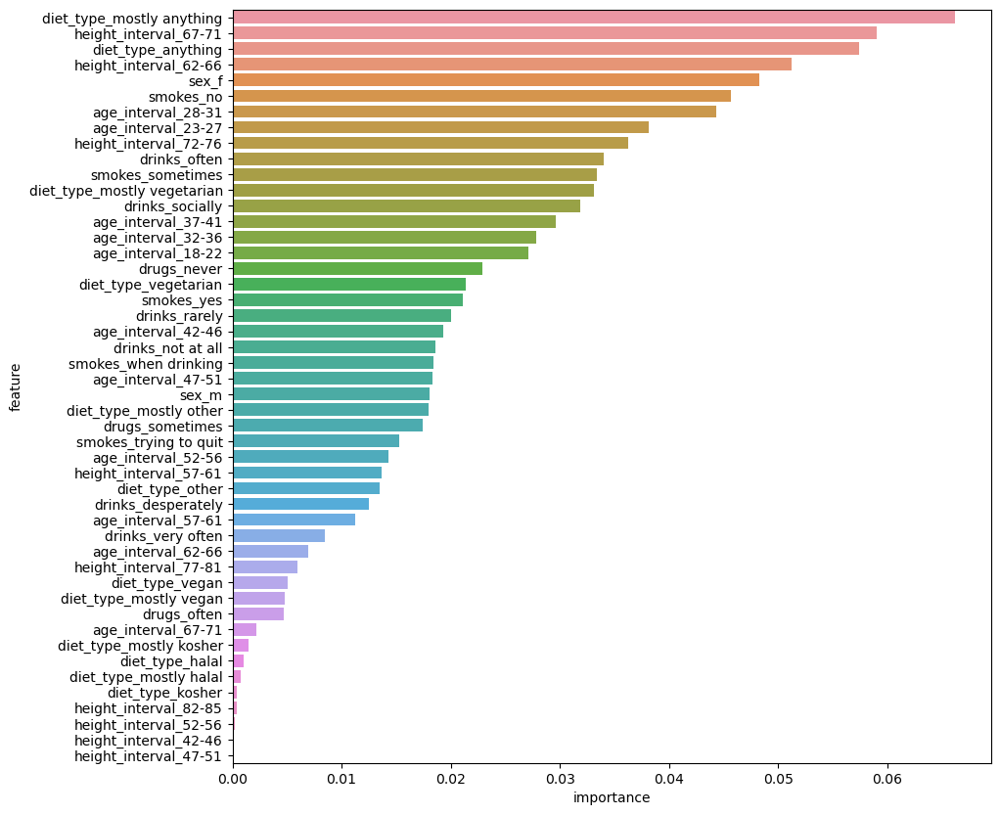

In [956]:
# Feature Importance
feature_importances_SMOTE = dt_model_SMOTE.feature_importances_
print(feature_importances_SMOTE)

sorted_indices_SMOTE  = feature_importances_SMOTE.argsort()[::-1]
sorted_feature_names_SMOTE  = X.columns.values[sorted_indices_SMOTE]
sorted_feature_names_SMOTE  = pd.DataFrame(data=sorted_feature_names_SMOTE, columns=['feature'])
sorted_importances_SMOTE  = feature_importances_SMOTE [sorted_indices_SMOTE ]
sorted_importances_SMOTE  = pd.DataFrame(data=sorted_importances_SMOTE, columns=['importance'])
sorted_importances_SMOTE_df = pd.concat([sorted_feature_names_SMOTE, sorted_importances_SMOTE ], axis=1)
print(sorted_importances_SMOTE_df)
plt.figure(figsize = (10,10))
sns.barplot(x= 'importance', y= 'feature', data =  sorted_importances_SMOTE_df)

From the top 15 most importantt featres, it can be seen that the most common features have more impact in the model. However, note that female ('sex_f') is a feature that is less common than male in our data. This potentially could mean that in the oversampling of the training data using SMOTE, the intersection of being a female with the most common other features is larger than the one with respect to males.  

Random Forest

We can see that depth and number of estimators do not have a huge impact in the accuracy of the random forest. Getting the best result with a depth of 30 and 25 estimators. However this score is not improved to the one obtained by a single decision tree.  

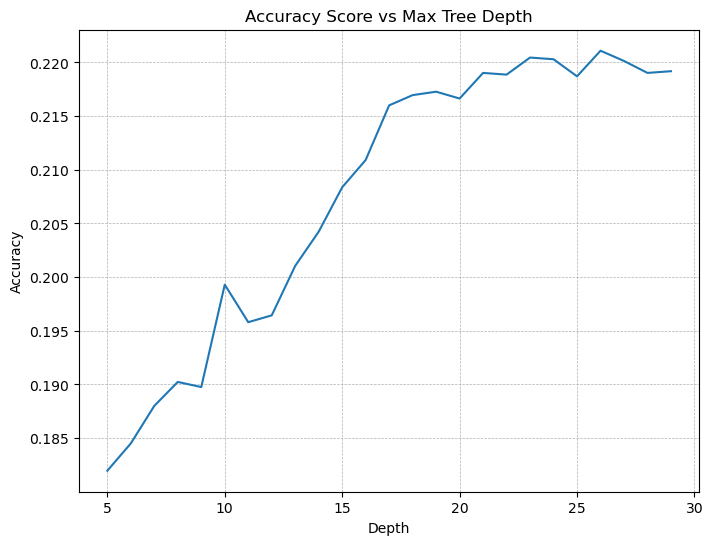

In [957]:
from sklearn.ensemble import RandomForestClassifier

# Seraching for the optimum tree depth
scores = []
depths = []
for depth in range(5, 30):   
    depths.append(depth)
    rfc_SMOTE = RandomForestClassifier(max_depth = depth, criterion = 'gini', random_state = 87)
    rfc_SMOTE.fit(X_train_SMOTE, Y_train_SMOTE)
    score = rfc_SMOTE.score(X_test, Y_test_labeled)
    scores.append(score)

plt.figure(figsize = (8,6))
plt.plot(depths, scores)
plt.title('Accuracy Score vs Max Tree Depth')
plt.xlabel('Depth')
plt.ylabel('Accuracy')
plt.grid(linestyle = '--', linewidth = 0.5)
plt.show()

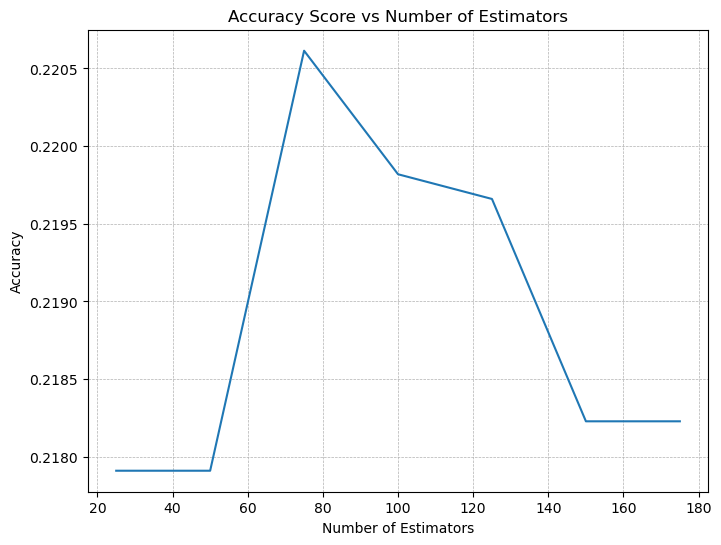

In [958]:
# Searching for the optimum number of estimators (trees)
scores = []
estimators = []
for n in range(25, 200, 25):   
    estimators.append(n)
    rfc_SMOTE = RandomForestClassifier(max_depth = 27, criterion = 'gini', n_estimators = n, random_state = 107)
    rfc_SMOTE.fit(X_train_SMOTE, Y_train_SMOTE)
    score = rfc_SMOTE.score(X_test, Y_test_labeled)
    scores.append(score)

plt.figure(figsize = (8,6))
plt.plot(estimators, scores)
plt.title('Accuracy Score vs Number of Estimators')
plt.xlabel('Number of Estimators')
plt.ylabel('Accuracy')
plt.grid(linestyle = '--', linewidth = 0.5)
plt.show()

##### Oversampling and downsampling

Decision tree

In [959]:
dt_model_up_dn_sampling = DecisionTreeClassifier().fit(X_train_2, Y_train_2) 
dt_predictions_up_dn_sampling = dt_model_up_dn_sampling.predict(X_train_2) 

In [960]:
print(classification_report(Y_train_2, dt_predictions_up_dn_sampling, zero_division=0))

                precision    recall  f1-score   support

a little extra       0.53      0.50      0.52      1000
      athletic       0.41      0.42      0.41      1000
       average       0.64      0.30      0.41      1000
         curvy       0.45      0.56      0.50      1000
           fit       0.45      0.30      0.36      1000
  full figured       0.53      0.64      0.58      1000
        jacked       0.64      0.77      0.70      1000
    overweight       0.66      0.74      0.70      1000
rather not say       0.49      0.88      0.63      1000
        skinny       0.66      0.52      0.58      1000
          thin       0.69      0.27      0.39      1000
       used up       0.72      0.81      0.76      1000

      accuracy                           0.56     12000
     macro avg       0.57      0.56      0.54     12000
  weighted avg       0.57      0.56      0.54     12000



A cross validation of the decision tree model shows a baseline of 41.76% which is about 13% lower that the accuracy obtained above. After predicting the test data we get 13% accuracy which is drastically lower. This means that our model cannot be generalised to other datasets and it is an indicator of overfit.

In [961]:
kfold = KFold(n_splits=5, shuffle=True, random_state=0)
results_dt_up_dn_sampling = cross_val_score(dt_model_up_dn_sampling, X_train_2, Y_train_2, cv=kfold, scoring='accuracy')
print(results_dt_up_dn_sampling)
print("Baseline: %.2f%% (%.2f%%)" % (results_dt_up_dn_sampling.mean()*100, results_dt_up_dn_sampling.std()*100))

[0.42291667 0.42166667 0.41166667 0.41208333 0.41666667]
Baseline: 41.70% (0.47%)


In [962]:
dt_predictions_test_up_dn_sampling = dt_model_up_dn_sampling.predict(X_test_2) 
print(classification_report(Y_test_2, dt_predictions_test_up_dn_sampling, zero_division=0))

                precision    recall  f1-score   support

a little extra       0.05      0.09      0.06       319
      athletic       0.29      0.21      0.24      1327
       average       0.29      0.06      0.09      1749
         curvy       0.18      0.28      0.22       478
           fit       0.27      0.11      0.16      1415
  full figured       0.05      0.24      0.08       107
        jacked       0.01      0.07      0.01        42
    overweight       0.01      0.06      0.01        51
rather not say       0.00      0.04      0.00        23
        skinny       0.05      0.13      0.07       183
          thin       0.12      0.08      0.09       554
       used up       0.01      0.08      0.02        39

      accuracy                           0.13      6287
     macro avg       0.11      0.12      0.09      6287
  weighted avg       0.23      0.13      0.14      6287



A depth of 29 branches indicates overfit of the data.

In [963]:
print(dt_model_up_dn_sampling.tree_.max_depth)

29


In [964]:
plt.figure(figsize = (100,100))
tree.plot_tree(dt_model_up_dn_sampling, filled = True)
plt.show()
plt.clf()

<Figure size 640x480 with 0 Axes>

[0.         0.04384758 0.03304855 0.03640168 0.04449673 0.03878026
 0.03310607 0.01912933 0.01852502 0.01550019 0.01433143 0.00889929
 0.00288327 0.02176163 0.02634255 0.01820058 0.01619139 0.01636714
 0.0144705  0.01888053 0.03455606 0.02296601 0.02521711 0.01942462
 0.02781403 0.01575881 0.02059854 0.04336453 0.00542103 0.00060159
 0.04984449 0.00156209 0.00687712 0.02905884 0.00871704 0.0302282
 0.01980048 0.01021036 0.02104207 0.00232011 0.         0.
 0.0171966  0.04140177 0.05360588 0.03618354 0.01381569 0.00124968]
                        feature  importance
0         height_interval_67-71    0.053606
1     diet_type_mostly anything    0.049844
2            age_interval_28-31    0.044497
3                         sex_m    0.043848
4            diet_type_anything    0.043365
5         height_interval_62-66    0.041402
6            age_interval_32-36    0.038780
7            age_interval_23-27    0.036402
8         height_interval_72-76    0.036184
9                  drinks_often 

<Axes: xlabel='importance', ylabel='feature'>

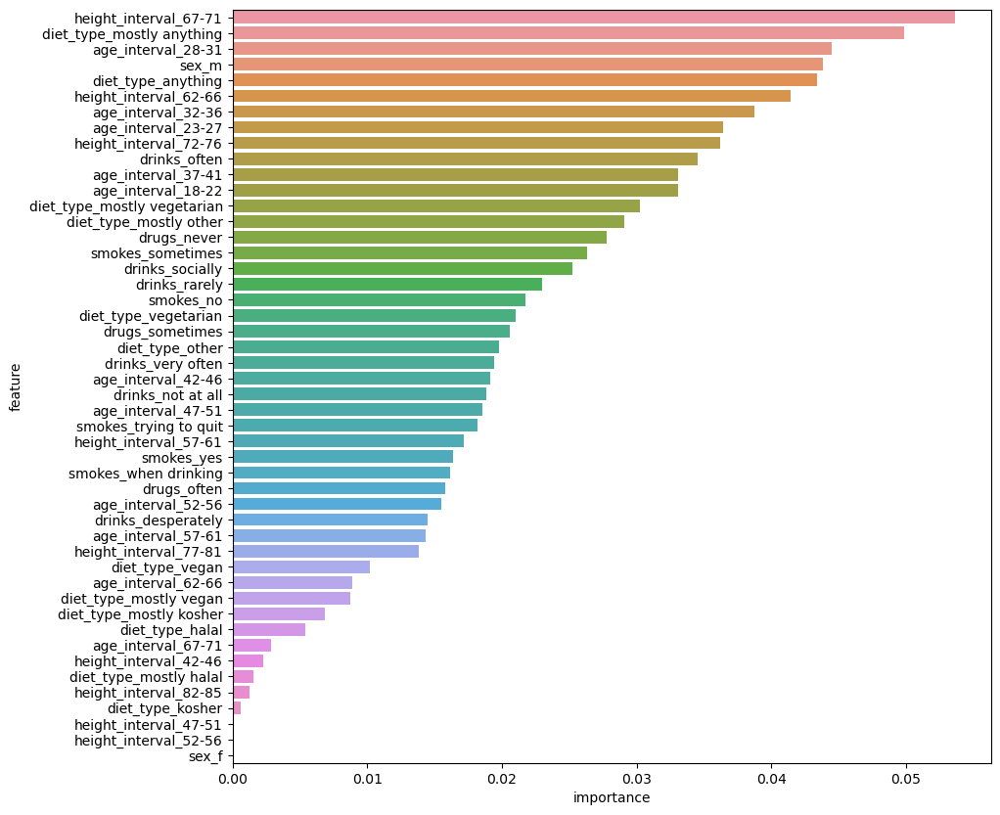

In [965]:
# Feature Importance
feature_importances_up_dn_sampling = dt_model_up_dn_sampling.feature_importances_
print(feature_importances_up_dn_sampling)

sorted_indices_up_dn_sampling = feature_importances_up_dn_sampling.argsort()[::-1]
sorted_feature_names_up_dn_sampling = X.columns.values[sorted_indices_up_dn_sampling]
sorted_feature_names_up_dn_sampling = pd.DataFrame(data=sorted_feature_names_up_dn_sampling, columns=['feature'])
sorted_importances_up_dn_sampling = feature_importances_up_dn_sampling[sorted_indices_up_dn_sampling]
sorted_importances_up_dn_sampling = pd.DataFrame(data=sorted_importances_up_dn_sampling, columns=['importance'])
sorted_importances_up_dn_sampling_df = pd.concat([sorted_feature_names_up_dn_sampling, sorted_importances_up_dn_sampling], axis=1)
print(sorted_importances_up_dn_sampling_df)
plt.figure(figsize = (10,10))
sns.barplot(x = 'importance', y = 'feature', data = sorted_importances_up_dn_sampling_df)

From the top 15 most importantt featres, it can be seen that the most common features have more impact in the model.  In this case female it is irrelevant in our model which could be a consequence of the intersection of female with the other most common features being small. If we compare the feature importance of this model with the one without addressing the imbalance that can be found below, we could see a similar distribution of the features with respect to their importance.  

Random Forest

 Depth and number of estimators do not have a huge impact in the accuracy of the random forest. Getting the best result (18%) with a depth of 5 and 25 estimators whihc is 5% higher than the accuracy score obtained by single decision tree. 

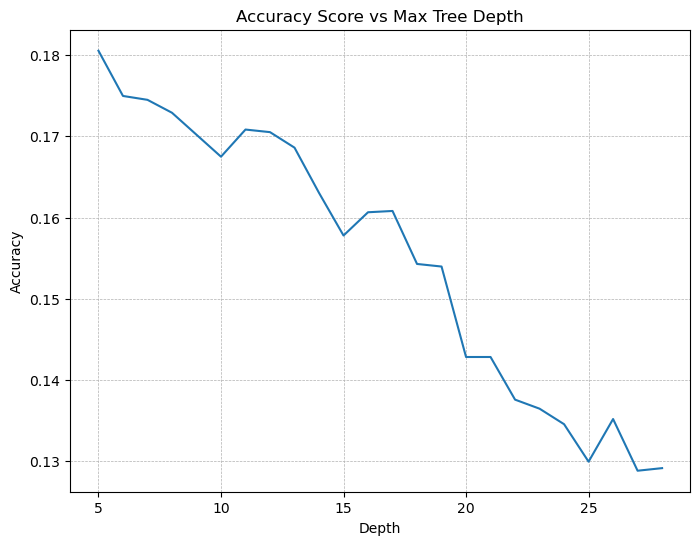

In [966]:
# Seraching for the optimum tree depth
scores = []
depths = []
for depth in range(5, 29):   
    depths.append(depth)
    rfc_up_dn_sampling = RandomForestClassifier(max_depth = depth, criterion = 'gini', random_state = 87)
    rfc_up_dn_sampling.fit(X_train_2, Y_train_2)
    score = rfc_up_dn_sampling.score(X_test_2, Y_test_2)
    scores.append(score)

plt.figure(figsize = (8,6))
plt.plot(depths, scores)
plt.title('Accuracy Score vs Max Tree Depth')
plt.xlabel('Depth')
plt.ylabel('Accuracy')
plt.grid(linestyle = '--', linewidth = 0.5)
plt.show()

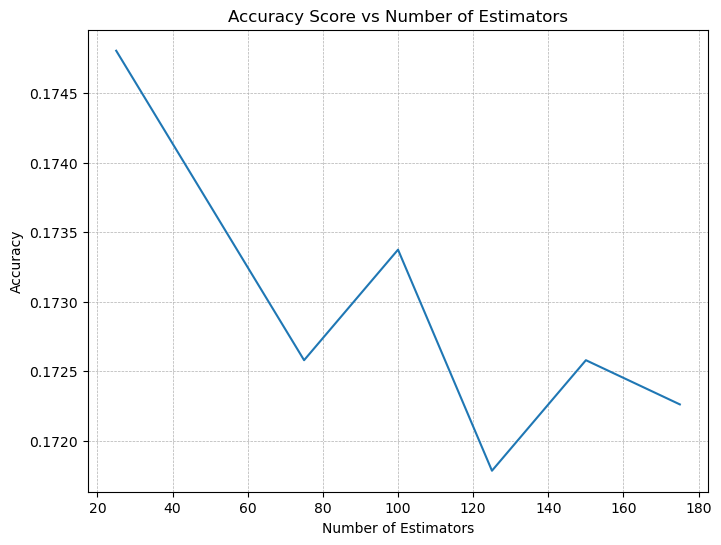

In [967]:
# Searching for the optimum number of estimators (trees)
scores = []
estimators = []
for n in range(25, 200, 25):   
    estimators.append(n)
    rfc_up_dn_sampling = RandomForestClassifier(max_depth = 5, criterion = 'gini', n_estimators = n, random_state = 107)
    rfc_up_dn_sampling.fit(X_train_2, Y_train_2)
    score = rfc_up_dn_sampling.score(X_test_2, Y_test_2)
    scores.append(score)

plt.figure(figsize = (8,6))
plt.plot(estimators, scores)
plt.title('Accuracy Score vs Number of Estimators')
plt.xlabel('Number of Estimators')
plt.ylabel('Accuracy')
plt.grid(linestyle = '--', linewidth = 0.5)
plt.show()

#### Imbalanced dataset

We will not cross validate the model as the accuracy score cannot be reliable for models where imbalance classes have not been addressed.

Decision tree

In [968]:
dt_model = DecisionTreeClassifier().fit(X_train, Y_train) 
dt_predictions = dt_model.predict(X_test) 

In [969]:
print(classification_report(Y_test, dt_predictions, zero_division=0))

                precision    recall  f1-score   support

a little extra       0.07      0.05      0.05       319
      athletic       0.29      0.48      0.37      1327
       average       0.29      0.36      0.32      1749
         curvy       0.18      0.12      0.14       478
           fit       0.25      0.20      0.22      1415
  full figured       0.06      0.02      0.03       107
        jacked       0.00      0.00      0.00        42
    overweight       0.00      0.00      0.00        51
rather not say       0.00      0.00      0.00        23
        skinny       0.07      0.02      0.03       183
          thin       0.12      0.04      0.06       554
       used up       0.00      0.00      0.00        39

      accuracy                           0.26      6287
     macro avg       0.11      0.11      0.10      6287
  weighted avg       0.23      0.26      0.24      6287



In [970]:
print(dt_model.tree_.max_depth)

31


In [971]:
plt.figure(figsize = (100,100))
tree.plot_tree(dt_model, filled = True)
plt.show()
plt.clf()

<Figure size 640x480 with 0 Axes>

[0.08921763 0.         0.02721975 0.03246142 0.03294085 0.03230757
 0.02449871 0.01925616 0.01897448 0.01603143 0.01308028 0.01072793
 0.00470329 0.01432835 0.01446425 0.01485569 0.01604659 0.01168479
 0.01014025 0.02533157 0.0250994  0.03390479 0.02954514 0.01790026
 0.03759775 0.01198188 0.02942881 0.04714035 0.00295787 0.002488
 0.04970403 0.00398375 0.00723832 0.02598425 0.01266083 0.02331478
 0.02234814 0.01670037 0.03067741 0.00063374 0.         0.00116518
 0.01975126 0.04270859 0.04376416 0.02277949 0.00853394 0.00173652]
                        feature  importance
0                         sex_f    0.089218
1     diet_type_mostly anything    0.049704
2            diet_type_anything    0.047140
3         height_interval_67-71    0.043764
4         height_interval_62-66    0.042709
5                   drugs_never    0.037598
6                 drinks_rarely    0.033905
7            age_interval_28-31    0.032941
8            age_interval_23-27    0.032461
9            age_interval

<Axes: xlabel='importance', ylabel='feature'>

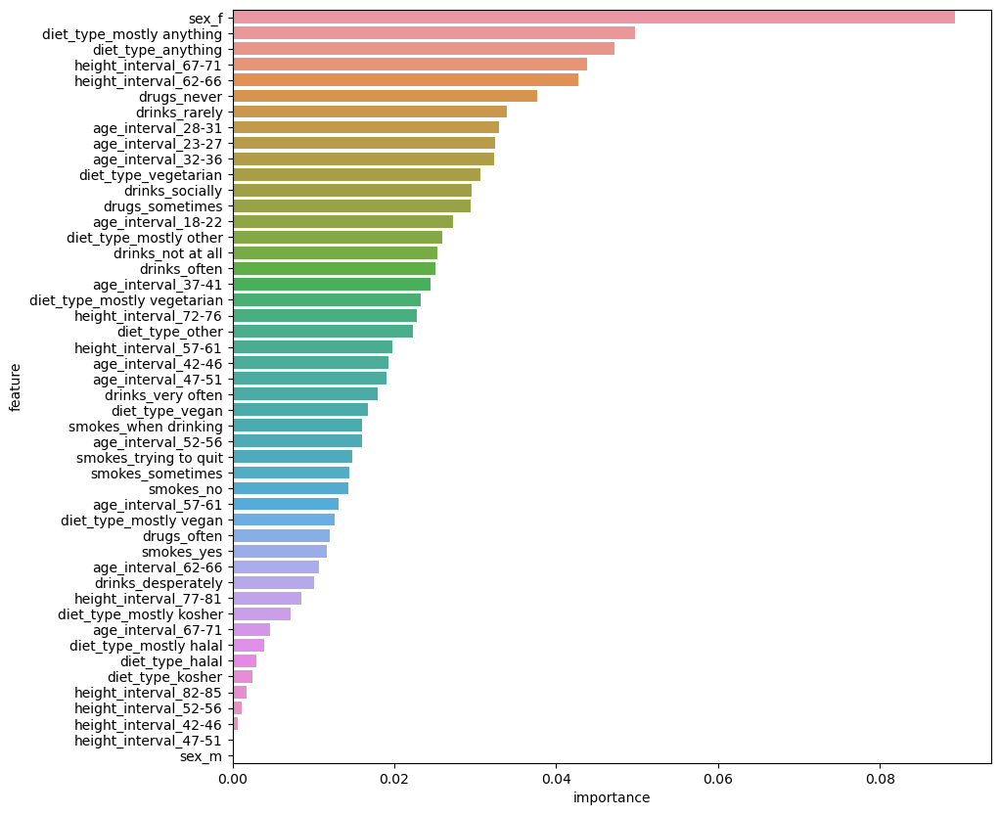

In [972]:
# Feature Importance
feature_importances= dt_model.feature_importances_
print(feature_importances)

sorted_indices = feature_importances.argsort()[::-1]
sorted_feature_names = X.columns.values[sorted_indices]
sorted_feature_names = pd.DataFrame(data=sorted_feature_names, columns=['feature'])
sorted_importances = feature_importances[sorted_indices]
sorted_importances = pd.DataFrame(data=sorted_importances, columns=['importance'])
sorted_importances_df = pd.concat([sorted_feature_names, sorted_importances], axis=1)
print(sorted_importances_df)
plt.figure(figsize = (10,10))
sns.barplot(x= 'importance', y= 'feature', data = sorted_importances_df)

Random Forest

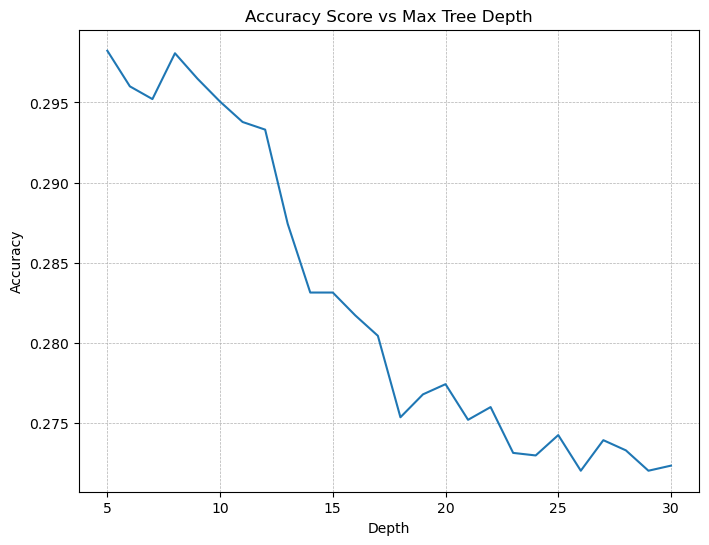

In [973]:
# Seraching for the optimum tree depth
scores = []
depths = []
for depth in range(5, 31):   
    depths.append(depth)
    rfc = RandomForestClassifier(max_depth = depth, criterion = 'gini', random_state = 87)
    rfc.fit(X_train, Y_train)
    score = rfc.score(X_test, Y_test)
    scores.append(score)

plt.figure(figsize = (8,6))
plt.plot(depths, scores)
plt.title('Accuracy Score vs Max Tree Depth')
plt.xlabel('Depth')
plt.ylabel('Accuracy')
plt.grid(linestyle = '--', linewidth = 0.5)
plt.show()

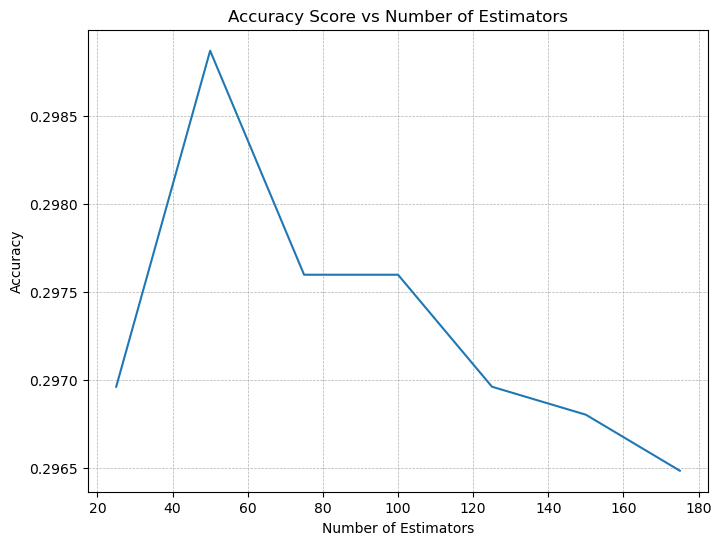

In [974]:
# Searching for the optimum number of estimators (trees)
scores = []
estimators = []
for n in range(25, 200, 25):   
    estimators.append(n)
    rfc = RandomForestClassifier(max_depth = 5, criterion = 'gini', n_estimators = n, random_state = 107)
    rfc.fit(X_train, Y_train)
    score = rfc.score(X_test, Y_test)
    scores.append(score)

plt.figure(figsize = (8,6))
plt.plot(estimators, scores)
plt.title('Accuracy Score vs Number of Estimators')
plt.xlabel('Number of Estimators')
plt.ylabel('Accuracy')
plt.grid(linestyle = '--', linewidth = 0.5)
plt.show()

#### Final model

The best model after using the tests sets is the Logistic Regression with SMOTE which obtain an accuracy of 26%. Below we show its confusion matrix.

From the confusion matrix it is clear that athetlic, average, curvy and fit were predicted most often, but not very accurate as there are wrong guesses with proportional instances as the correct ones.

Recall that the encoder map is based on alphabetic order\
0 ---> a little extra\
1 ---> athletic\
2 ---> average\
3 ---> curvy\
4 ---> fit\
5 ---> full figured\
6 ---> jacked\
7 ---> overweight\
8 ---> rather not say\
9 ---> skinny\
10 ---> thin\
11 ---> used up

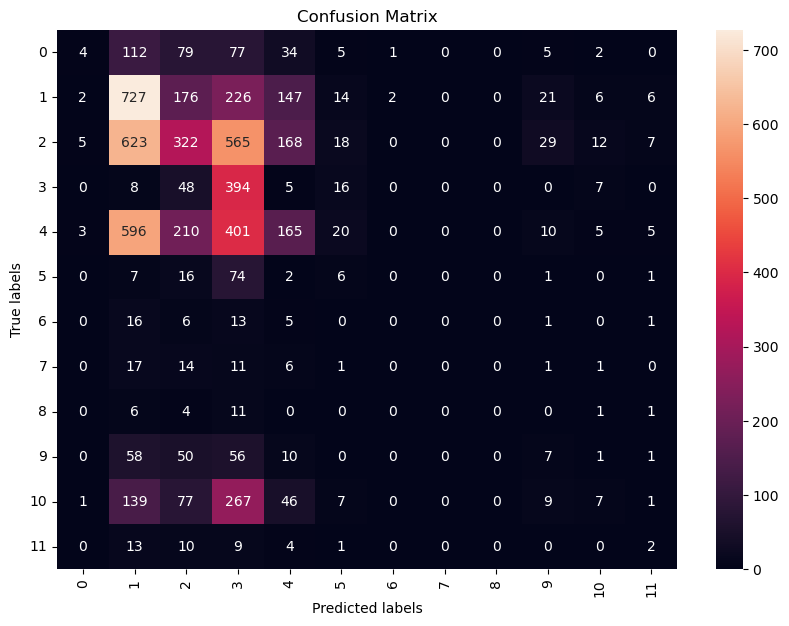

In [975]:
from sklearn.metrics import confusion_matrix 
lr_model_SMOTE_cm = confusion_matrix(Y_test_labeled, lr_predictions_test_SMOTE)
lr_model_SMOTE_labels = lr_model_SMOTE.classes_

plt.figure(figsize=(10,7))

ax= plt.subplot()
sns.heatmap(lr_model_SMOTE_cm, annot=True, ax = ax,fmt="d");

# labels, title and ticks
ax.set_xlabel('Predicted labels');
ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix');
ax.yaxis.set_tick_params(rotation=360)
ax.xaxis.set_tick_params(rotation=90)

ax.xaxis.set_ticklabels(dt_model_SMOTE_labels); 
ax.yaxis.set_ticklabels(dt_model_SMOTE_labels);


## Conclusions

In this project machine learning was used to predict the body type and income of OkCupid users. The classification predictive models had a low accuracy score overall. During the exploration and cleaning of the data, it was clear that it would be a difficult task as the categories of most of the columns were highly imbalanced, nevertheless they were carried out and contributed a lot to author's learning. Despite our efforts, the final selected algorithms did no better than basic guessing.

Next steps will be to seriously consider whether it is possible to predict someone's body type and income based on better features or if there is a way to do it with more accurate data. Another option is to look at additional models or tune the hyper parameters of the models investigated to see if any more predictive power could be obtain from the algorithms. 